# Face Generation

In this project, you'll define and train a Generative Adverserial network of your own creation on a dataset of faces. Your goal is to get a generator network to generate *new* images of faces that look as realistic as possible!

The project will be broken down into a series of tasks from **defining new architectures training adversarial networks**. At the end of the notebook, you'll be able to visualize the results of your trained Generator to see how it performs; your generated samples should look like fairly realistic faces with small amounts of noise.

### Get the Data

You'll be using the [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) to train your adversarial networks.

This dataset has higher resolution images than datasets you have previously worked with (like MNIST or SVHN) you've been working with, and so, you should prepare to define deeper networks and train them for a longer time to get good results. It is suggested that you utilize a GPU for training.

### Pre-processed Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. Some sample data is show below.

<img src='assets/processed_face_data.png' width=60% />

> If you are working locally, you can download this data [by clicking here](https://s3.amazonaws.com/video.udacity-data.com/topher/2018/November/5be7eb6f_processed-celeba-small/processed-celeba-small.zip)

This is a zip file that you'll need to extract in the home directory of this notebook for further loading and processing. After extracting the data, you should be left with a directory of data `processed-celeba-small/`.

In [2]:
# run this once to unzip the file
!unzip processed-celeba-small.zip

Archive:  processed-celeba-small.zip
   creating: processed_celeba_small/
  inflating: processed_celeba_small/.DS_Store  
   creating: __MACOSX/
   creating: __MACOSX/processed_celeba_small/
  inflating: __MACOSX/processed_celeba_small/._.DS_Store  
   creating: processed_celeba_small/celeba/
  inflating: processed_celeba_small/celeba/.DS_Store  
   creating: __MACOSX/processed_celeba_small/celeba/
  inflating: __MACOSX/processed_celeba_small/celeba/._.DS_Store  
  inflating: processed_celeba_small/celeba/161979.jpg  
  inflating: processed_celeba_small/celeba/161980.jpg  
  inflating: processed_celeba_small/celeba/161981.jpg  
  inflating: processed_celeba_small/celeba/161982.jpg  
  inflating: processed_celeba_small/celeba/161983.jpg  
  inflating: processed_celeba_small/celeba/161984.jpg  
  inflating: processed_celeba_small/celeba/161985.jpg  
  inflating: processed_celeba_small/celeba/161986.jpg  
  inflating: processed_celeba_small/celeba/161987.jpg  
  inflating: processed_celeb

In [1]:
from glob import glob
from typing import Tuple, Callable, Dict

import matplotlib.pyplot as plt
import numpy as np
import torch
from PIL import Image
from torch.utils.data import DataLoader, Dataset
from torchvision.transforms import Compose, ToTensor

import tests

In [2]:
data_dir = 'processed_celeba_small/celeba/'

## Data pipeline

The [CelebA](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations. Since you're going to be generating faces, you won't need the annotations, you'll only need the images. Note that these are color images with [3 color channels (RGB)](https://en.wikipedia.org/wiki/Channel_(digital_image)#RGB_Images) each.

### Pre-process and Load the Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. This *pre-processed* dataset is a smaller subset of the very large CelebA dataset and contains roughly 30,000 images. 

Your first task consists in building the dataloader. To do so, you need to do the following:
* implement the get_transforms function
* create a custom Dataset class that reads the CelebA data

### Exercise: implement the get_transforms function

The `get_transforms` function should output a [`torchvision.transforms.Compose`](https://pytorch.org/vision/stable/generated/torchvision.transforms.Compose.html#torchvision.transforms.Compose) of different transformations. You have two constraints:
* the function takes a tuple of size as input and should **resize the images** to the input size
* the output images should have values **ranging from -1 to 1**

In [3]:
from torchvision.transforms import Compose, Resize, ToTensor, Normalize

def get_transforms(size: Tuple[int, int]) -> Callable:
    """Transforms to apply to the image."""
    # Define a list of transformations to apply
    transforms = [
        Resize(size),  # Resize the image to the specified size
        ToTensor(),     # Convert the image to a PyTorch tensor
        Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])  # Normalize pixel values 
    ]
    
    return Compose(transforms)


In [4]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


### Exercise: implement the DatasetDirectory class


The `DatasetDirectory` class is a torch Dataset that reads from the above data directory. The `__getitem__` method should output a transformed tensor and the `__len__` method should output the number of files in our dataset. You can look at [this custom dataset](https://pytorch.org/tutorials/beginner/basics/data_tutorial.html#creating-a-custom-dataset-for-your-files) for ideas. 

In [20]:
import os
from PIL import Image
import torch
from torch.utils.data import Dataset
from typing import Callable

class DatasetDirectory(Dataset):
    """
    A custom dataset class that loads images from a folder.
    Args:
    - directory: location of the images
    - transform: transform function to apply to the images
    - extension: file format
    """
    def __init__(self, 
                 directory: str, 
                 transforms: Callable = None, 
                 extension: str = '.jpg'):
        # Initialize the dataset by storing the directory, transform function, and extension
        self.directory = directory
        self.transforms = transforms
        self.extension = extension
        
        # Create a list of image file paths in the specified directory with the given extension
        self.image_paths = [os.path.join(directory, file) for file in os.listdir(directory) if file.endswith(extension)]

    def __len__(self) -> int:
        """Returns the number of items in the dataset."""
        # Return the number of elements in the dataset, which is the length of the list of image file paths
        return len(self.image_paths)

    def __getitem__(self, index: int) -> torch.Tensor:
        """Load an image and apply transformation."""
        # Get the image path at the specified index
        image_path = self.image_paths[index]
        
        # Open the image using PIL
        image = Image.open(image_path)
        
        # Apply the transformation if it's provided
        if self.transforms is not None:
            image = self.transforms(image)
        
        # Return the transformed image as a PyTorch tensor
        return image


In [21]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to verify your dataset implementation
dataset = DatasetDirectory(data_dir, get_transforms((64, 64)))
tests.check_dataset_outputs(dataset)

Congrats, your dataset implementation passed all the tests


The functions below will help you visualize images from the dataset.

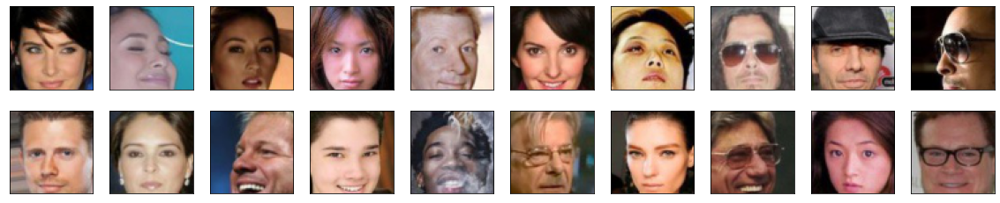

In [22]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""

def denormalize(images):
    """Transform images from [-1.0, 1.0] to [0, 255] and cast them to uint8."""
    return ((images + 1.) / 2. * 255).astype(np.uint8)

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(20, 4))
plot_size=20
for idx in np.arange(plot_size):
    ax = fig.add_subplot(2, int(plot_size/2), idx+1, xticks=[], yticks=[])
    img = dataset[idx].numpy()
    img = np.transpose(img, (1, 2, 0))
    img = denormalize(img)
    ax.imshow(img)

## Model implementation

As you know, a GAN is comprised of two adversarial networks, a discriminator and a generator. Now that we have a working data pipeline, we need to implement the discriminator and the generator. 

Feel free to implement any additional class or function.

### Exercise: Create the discriminator

The discriminator's job is to score real and fake images. You have two constraints here:
* the discriminator takes as input a **batch of 64x64x3 images**
* the output should be a single value (=score)

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips
* To scale down from the input image, you can either use `Conv2d` layers with the correct hyperparameters or Pooling layers.
* If you plan on using gradient penalty, do not use Batch Normalization layers in the discriminator.

In [23]:
from torch.nn import Module

In [56]:
import torch
import torch.nn as nn

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        # Define the layers of the discriminator
        self.layers = nn.Sequential(
            # Input: 64x64x3
            nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.01, inplace=True),
            
            # 32x32x64
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
#             nn.BatchNorm2d(128),
            nn.LeakyReLU(0.01, inplace=True),
            
            # 16x16x128
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
#             nn.BatchNorm2d(256),
            nn.LeakyReLU(0.01, inplace=True),
            
            # 8x8x256
            nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1),
#             nn.BatchNorm2d(512),
            nn.LeakyReLU(0.01, inplace=True),
            
            # 4x4x512
            nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0),
        )

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # Forward pass through the discriminator layers
        return self.layers(x)

In [57]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to check your discriminator implementation
discriminator = Discriminator()
tests.check_discriminator(discriminator)

Congrats, your discriminator implementation passed all the tests


### Exercise: create the generator

The generator's job creates the "fake images" and learns the dataset distribution. You have three constraints here:
* the generator takes as input a vector of dimension `[batch_size, latent_dimension, 1, 1]`
* the generator must outputs **64x64x3 images**

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips:
* to scale up from the latent vector input, you can use `ConvTranspose2d` layers
* as often with Gan, **Batch Normalization** helps with training

In [58]:
import torch
import torch.nn as nn

class Generator(nn.Module):
    def __init__(self, latent_dim: int):
        super(Generator, self).__init__()

        # Define the layers of the generator
        self.layers = nn.Sequential(
            # Input: [batch_size, latent_dim, 1, 1]
            nn.ConvTranspose2d(latent_dim, 512, kernel_size=4, stride=1, padding=0),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.01, inplace=True),
            
            # 4x4x512
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.01, inplace=True),
            
            # 8x8x256
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.01, inplace=True),
            
            # 16x16x128
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.01, inplace=True),
            
            # 32x32x64
            nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1),
            nn.Tanh()  # Output a 64x64x3 image with pixel values in the range [-1, 1]
        )

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # Forward pass through the generator layers
        return self.layers(x)

# Instantiate the generator
latent_dim = 100  # You can choose the dimensionality of the latent vector
generator = Generator(latent_dim)


In [59]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to verify your generator implementation
latent_dim = 128
generator = Generator(latent_dim)
tests.check_generator(generator, latent_dim)

Congrats, your generator implementation passed all the tests


## Optimizer

In the following section, we create the optimizers for the generator and discriminator. You may want to experiment with different optimizers, learning rates and other hyperparameters as they tend to impact the output quality.

### Exercise: implement the optimizers

In [60]:
def create_optimizers(generator: Module, discriminator: Module):
    """This function should return the optimizers of the generator and the discriminator."""
    
    # Define the optimizer for the generator
    g_optimizer = optim.RMSprop(generator.parameters(), lr=0.00005)
    
    # Define the optimizer for the discriminator
    d_optimizer = optim.RMSprop(discriminator.parameters(), lr=0.00005)
    
    return g_optimizer, d_optimizer


## Losses implementation

In this section, we are going to implement the loss function for the generator and the discriminator. You can and should experiment with different loss function.

Some tips:
* You can choose the commonly used the binary cross entropy loss or select other losses we have discovered in the course, such as the Wasserstein distance.
* You may want to implement a gradient penalty function as discussed in the course. It is not required and the code will work whether you implement it or not.

### Exercise: implement the generator loss

The generator's goal is to get the discriminator to think its generated images (= "fake" images) are real.

In [61]:
import torch
import torch.nn.functional as F

def generator_loss(fake_scores):
    """Generator loss for WGAN, takes the fake scores as inputs."""
    return -torch.mean(fake_scores)


### Exercise: implement the discriminator loss

We want the discriminator to give high scores to real images and low scores to fake ones and the discriminator loss should reflect that.

In [62]:
import torch
import torch.nn.functional as F

def discriminator_loss(real_scores, fake_scores):
    """Discriminator loss for WGAN."""
    return -torch.mean(real_scores) + torch.mean(fake_scores)


### Exercise (Optional): Implement the gradient Penalty

In the course, we discussed the importance of gradient penalty in training certain types of Gans. Implementing this function is not required and depends on some of the design decision you made (discriminator architecture, loss functions).

In [63]:
# def gradient_penalty(discriminator, real_samples, fake_samples):
#     """ This function enforces """
#     gp = 0
#     # TODO (Optional): implement the gradient penalty
#     return gp

In [64]:
import torch
import torch.autograd as autograd

def gradient_penalty(discriminator, real_samples, fake_samples):
    """This function enforces gradient penalty for WGAN-GP."""
    
    # Generate random epsilon values for interpolation between real and fake samples
    epsilon = torch.rand(real_samples.size(0), 1, 1, 1).to(real_samples.device)
    
    # Create interpolated samples by combining real and fake samples
    interpolated_samples = epsilon * real_samples + (1 - epsilon) * fake_samples
    
    # Calculate the discriminator's scores for the interpolated samples
    interpolated_scores = discriminator(interpolated_samples)
    
    # Compute the gradients of the interpolated scores with respect to the interpolated samples
    gradients = autograd.grad(outputs=interpolated_scores, inputs=interpolated_samples,
                             grad_outputs=torch.ones_like(interpolated_scores),
                             create_graph=True, retain_graph=True)[0]
    
    # Calculate the gradient penalty as the L2 norm of the gradients
    gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()
    
    return gradient_penalty


## Training


Training will involve alternating between training the discriminator and the generator. You'll use your functions real_loss and fake_loss to help you calculate the discriminator losses.

* You should train the discriminator by alternating on real and fake images
* Then the generator, which tries to trick the discriminator and should have an opposing loss function

### Exercise: implement the generator step and the discriminator step functions

Each function should do the following:
* calculate the loss
* backpropagate the gradient
* perform one optimizer step

In [65]:
generator.apply(weights_init)
discriminator.apply(weights_init)

Discriminator(
  (layers): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.01, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (3): LeakyReLU(negative_slope=0.01, inplace=True)
    (4): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (5): LeakyReLU(negative_slope=0.01, inplace=True)
    (6): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): LeakyReLU(negative_slope=0.01, inplace=True)
    (8): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1))
  )
)

In [66]:
import torch
import torch.optim as optim
from typing import Dict
from torch.autograd import Variable
from torch.nn import functional as F

g_optimizer, d_optimizer = create_optimizers(generator, discriminator)

def generator_step(batch_size: int, latent_dim: int) -> Dict:
    """One training step of the generator."""
    
    # Generate random noise as the input to the generator
    noise = torch.randn(batch_size, latent_dim, 1, 1).to(device)
    
    # Generate fake images from the noise
    fake_images = generator(noise)
    
    # Calculate the discriminator's scores for the fake images
    fake_scores = discriminator(fake_images)
    
    # Calculate the generator loss
    g_loss = -torch.mean(fake_scores)  # Generator wants the discriminator to output 1
    
    # Backpropagate the gradient and update the generator's parameters
    g_optimizer.zero_grad()
    g_loss.backward()
    g_optimizer.step()
    
    return {'loss': g_loss.item()}

def discriminator_step(batch_size: int, latent_dim: int, real_images: torch.Tensor) -> Dict:
    """One training step of the discriminator."""
    
    # Generate random noise as the input to the generator
    noise = torch.randn(batch_size, latent_dim, 1, 1).to(device)
    
    # Generate fake images from the noise
    fake_images = generator(noise)
    
    # Calculate the discriminator's scores for real and fake images
    real_scores = discriminator(real_images)
    fake_scores = discriminator(fake_images.detach())
    
    # Calculate the discriminator loss
    d_loss = -torch.mean(real_scores) + torch.mean(fake_scores)
    
    # Compute the gradient penalty (optional)
    gp = gradient_penalty(discriminator, real_images, fake_images)
    
    # Add the gradient penalty to the discriminator loss (if used)
    d_loss += gp
    
    # Backpropagate the gradient and update the discriminator's parameters
    d_optimizer.zero_grad()
    d_loss.backward()
    d_optimizer.step()
    for p in discriminator.parameters():
        p.data.clamp_(-0.01, 0.01)
        
    return {'loss': d_loss.item(), 'gp': gp.item()}



### Main training loop

You don't have to implement anything here but you can experiment with different hyperparameters.

In [67]:
from datetime import datetime

In [68]:
# you can experiment with different dimensions of latent spaces
latent_dim = 64

# update to cpu if you do not have access to a gpu
device = 'cuda'

# number of epochs to train your model
n_epochs = 60

# number of images in each batch
batch_size = 32

In [69]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
print_every = 50

# Create optimizers for the discriminator D and generator G
generator = Generator(latent_dim).to(device)
discriminator = Discriminator().to(device)
g_optimizer, d_optimizer = create_optimizers(generator, discriminator)

dataloader = DataLoader(dataset, 
                        batch_size=64, 
                        shuffle=True, 
                        num_workers=4, 
                        drop_last=True,
                        pin_memory=False)

In [70]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""

def display(fixed_latent_vector: torch.Tensor):
    """ helper function to display images during training """
    fig = plt.figure(figsize=(14, 4))
    plot_size = 16
    for idx in np.arange(plot_size):
        ax = fig.add_subplot(2, int(plot_size/2), idx+1, xticks=[], yticks=[])
        img = fixed_latent_vector[idx, ...].detach().cpu().numpy()
        img = np.transpose(img, (1, 2, 0))
        img = denormalize(img)
        ax.imshow(img)
    plt.show()

### Exercise: implement the training strategy

You should experiment with different training strategies. For example:

* train the generator more often than the discriminator. 
* added noise to the input image
* use label smoothing

Implement with your training strategy below.

2023-11-02 18:08:49 | Epoch [1/60] | Batch 0/509 | d_loss: 9.9953 | g_loss: 0.2659
2023-11-02 18:08:57 | Epoch [1/60] | Batch 50/509 | d_loss: -6635.6040 | g_loss: 3884.5801
2023-11-02 18:09:04 | Epoch [1/60] | Batch 100/509 | d_loss: -19398.6914 | g_loss: 18041.6621
2023-11-02 18:09:12 | Epoch [1/60] | Batch 150/509 | d_loss: -33437.5156 | g_loss: 32378.7402
2023-11-02 18:09:19 | Epoch [1/60] | Batch 200/509 | d_loss: -7681.8242 | g_loss: 6888.2964
2023-11-02 18:09:27 | Epoch [1/60] | Batch 250/509 | d_loss: 7142.6279 | g_loss: 21818.6484
2023-11-02 18:09:34 | Epoch [1/60] | Batch 300/509 | d_loss: 3344.2588 | g_loss: 6071.3374
2023-11-02 18:09:42 | Epoch [1/60] | Batch 350/509 | d_loss: 3037.5308 | g_loss: 2295.5244
2023-11-02 18:09:49 | Epoch [1/60] | Batch 400/509 | d_loss: 1756.1063 | g_loss: 1874.8844
2023-11-02 18:09:57 | Epoch [1/60] | Batch 450/509 | d_loss: -348.1055 | g_loss: 3734.6265
2023-11-02 18:10:04 | Epoch [1/60] | Batch 500/509 | d_loss: 463.8564 | g_loss: 424.6585


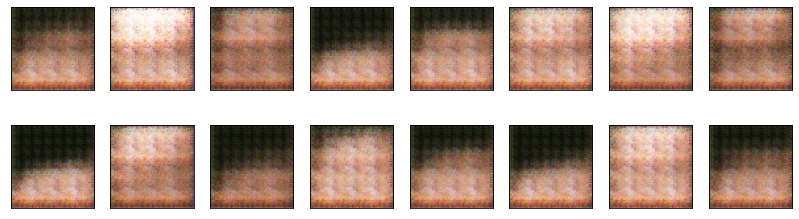

2023-11-02 18:10:10 | Epoch [2/60] | Batch 0/509 | d_loss: 1050.4712 | g_loss: -1868.7119
2023-11-02 18:10:17 | Epoch [2/60] | Batch 50/509 | d_loss: 232.0839 | g_loss: 2801.4365
2023-11-02 18:10:25 | Epoch [2/60] | Batch 100/509 | d_loss: -732.2715 | g_loss: -4965.7061
2023-11-02 18:10:32 | Epoch [2/60] | Batch 150/509 | d_loss: -964.5460 | g_loss: 3470.4526
2023-11-02 18:10:40 | Epoch [2/60] | Batch 200/509 | d_loss: -1021.7225 | g_loss: 5615.4316
2023-11-02 18:10:47 | Epoch [2/60] | Batch 250/509 | d_loss: -1122.5754 | g_loss: -620.2648
2023-11-02 18:10:55 | Epoch [2/60] | Batch 300/509 | d_loss: -657.8257 | g_loss: -1575.7101
2023-11-02 18:11:02 | Epoch [2/60] | Batch 350/509 | d_loss: -1061.7180 | g_loss: 1939.3363
2023-11-02 18:11:10 | Epoch [2/60] | Batch 400/509 | d_loss: -1065.2094 | g_loss: 4544.2783
2023-11-02 18:11:17 | Epoch [2/60] | Batch 450/509 | d_loss: -1187.2273 | g_loss: 3184.3845
2023-11-02 18:11:25 | Epoch [2/60] | Batch 500/509 | d_loss: -1175.3262 | g_loss: 7354

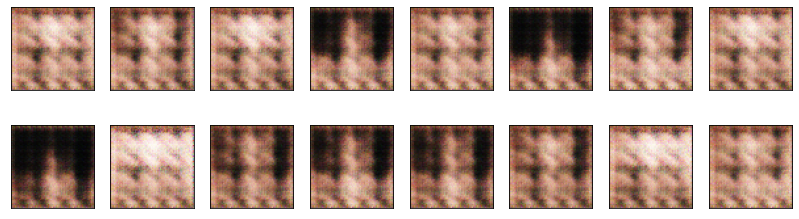

2023-11-02 18:11:30 | Epoch [3/60] | Batch 0/509 | d_loss: -1070.4214 | g_loss: 578.4218
2023-11-02 18:11:38 | Epoch [3/60] | Batch 50/509 | d_loss: -977.0214 | g_loss: 267.3604
2023-11-02 18:11:45 | Epoch [3/60] | Batch 100/509 | d_loss: -1300.0856 | g_loss: 3987.5117
2023-11-02 18:11:53 | Epoch [3/60] | Batch 150/509 | d_loss: -1553.1908 | g_loss: 526.1343
2023-11-02 18:12:00 | Epoch [3/60] | Batch 200/509 | d_loss: -1049.5714 | g_loss: 46.4985
2023-11-02 18:12:08 | Epoch [3/60] | Batch 250/509 | d_loss: -502.4888 | g_loss: 1828.8088
2023-11-02 18:12:15 | Epoch [3/60] | Batch 300/509 | d_loss: -629.4814 | g_loss: 558.0874
2023-11-02 18:12:23 | Epoch [3/60] | Batch 350/509 | d_loss: -661.6584 | g_loss: 2657.4722
2023-11-02 18:12:30 | Epoch [3/60] | Batch 400/509 | d_loss: -783.3696 | g_loss: 3125.2393
2023-11-02 18:12:38 | Epoch [3/60] | Batch 450/509 | d_loss: -677.7074 | g_loss: 2241.3516
2023-11-02 18:12:45 | Epoch [3/60] | Batch 500/509 | d_loss: -400.8920 | g_loss: 977.6549


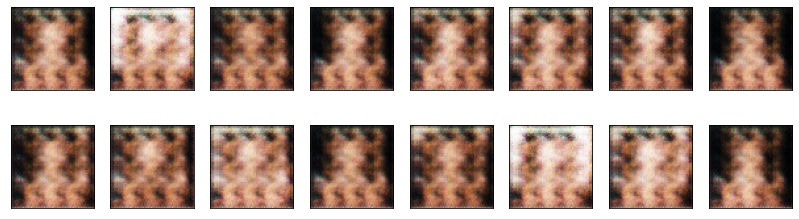

2023-11-02 18:12:50 | Epoch [4/60] | Batch 0/509 | d_loss: 49.9818 | g_loss: -995.9684
2023-11-02 18:12:57 | Epoch [4/60] | Batch 50/509 | d_loss: -357.0624 | g_loss: 3370.4011
2023-11-02 18:13:05 | Epoch [4/60] | Batch 100/509 | d_loss: -516.5825 | g_loss: 4967.6157
2023-11-02 18:13:12 | Epoch [4/60] | Batch 150/509 | d_loss: -699.8782 | g_loss: 2719.2231
2023-11-02 18:13:20 | Epoch [4/60] | Batch 200/509 | d_loss: -284.2592 | g_loss: 1580.4529
2023-11-02 18:13:28 | Epoch [4/60] | Batch 250/509 | d_loss: 351.6399 | g_loss: 3925.5195
2023-11-02 18:13:35 | Epoch [4/60] | Batch 300/509 | d_loss: -28.6228 | g_loss: 1690.0259
2023-11-02 18:13:43 | Epoch [4/60] | Batch 350/509 | d_loss: 95.6988 | g_loss: 3316.6289
2023-11-02 18:13:50 | Epoch [4/60] | Batch 400/509 | d_loss: -269.6914 | g_loss: 1716.5382
2023-11-02 18:13:58 | Epoch [4/60] | Batch 450/509 | d_loss: -483.7797 | g_loss: 1774.2413
2023-11-02 18:14:05 | Epoch [4/60] | Batch 500/509 | d_loss: -431.0874 | g_loss: 1490.7129


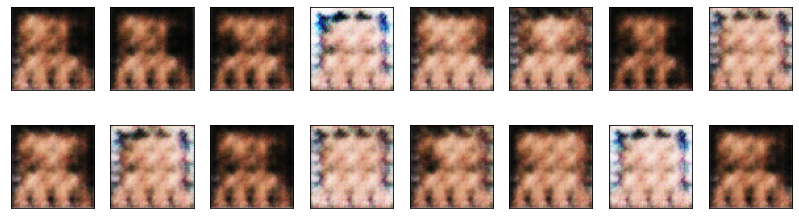

2023-11-02 18:14:11 | Epoch [5/60] | Batch 0/509 | d_loss: -397.5468 | g_loss: 2623.4690
2023-11-02 18:14:18 | Epoch [5/60] | Batch 50/509 | d_loss: -287.6096 | g_loss: 7695.2803
2023-11-02 18:14:26 | Epoch [5/60] | Batch 100/509 | d_loss: -30.6185 | g_loss: 2343.4609
2023-11-02 18:14:33 | Epoch [5/60] | Batch 150/509 | d_loss: -248.2415 | g_loss: -2303.2561
2023-11-02 18:14:41 | Epoch [5/60] | Batch 200/509 | d_loss: -357.8618 | g_loss: 2650.4451
2023-11-02 18:14:48 | Epoch [5/60] | Batch 250/509 | d_loss: -516.9211 | g_loss: 6983.4028
2023-11-02 18:14:56 | Epoch [5/60] | Batch 300/509 | d_loss: -355.3896 | g_loss: -554.9714
2023-11-02 18:15:03 | Epoch [5/60] | Batch 350/509 | d_loss: -281.8784 | g_loss: 1371.7111
2023-11-02 18:15:11 | Epoch [5/60] | Batch 400/509 | d_loss: -393.5349 | g_loss: -1963.3220
2023-11-02 18:15:18 | Epoch [5/60] | Batch 450/509 | d_loss: -482.6288 | g_loss: -1414.1797
2023-11-02 18:15:26 | Epoch [5/60] | Batch 500/509 | d_loss: -255.2942 | g_loss: -461.9113


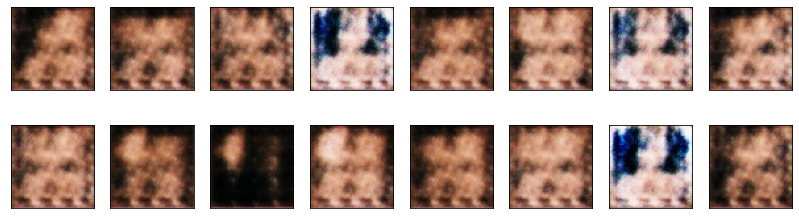

2023-11-02 18:15:31 | Epoch [6/60] | Batch 0/509 | d_loss: -364.1849 | g_loss: 5631.4097
2023-11-02 18:15:38 | Epoch [6/60] | Batch 50/509 | d_loss: -356.8813 | g_loss: 608.1562
2023-11-02 18:15:46 | Epoch [6/60] | Batch 100/509 | d_loss: -350.3840 | g_loss: 2861.7651
2023-11-02 18:15:53 | Epoch [6/60] | Batch 150/509 | d_loss: -513.4141 | g_loss: 2511.6841
2023-11-02 18:16:01 | Epoch [6/60] | Batch 200/509 | d_loss: -303.0692 | g_loss: -1593.3613
2023-11-02 18:16:08 | Epoch [6/60] | Batch 250/509 | d_loss: -178.7709 | g_loss: 2967.0796
2023-11-02 18:16:16 | Epoch [6/60] | Batch 300/509 | d_loss: -280.0374 | g_loss: -2808.3591
2023-11-02 18:16:23 | Epoch [6/60] | Batch 350/509 | d_loss: -378.5251 | g_loss: 3214.8594
2023-11-02 18:16:31 | Epoch [6/60] | Batch 400/509 | d_loss: -378.8966 | g_loss: -2335.7910
2023-11-02 18:16:38 | Epoch [6/60] | Batch 450/509 | d_loss: -363.9519 | g_loss: -1382.9336
2023-11-02 18:16:46 | Epoch [6/60] | Batch 500/509 | d_loss: -303.6598 | g_loss: 366.0784


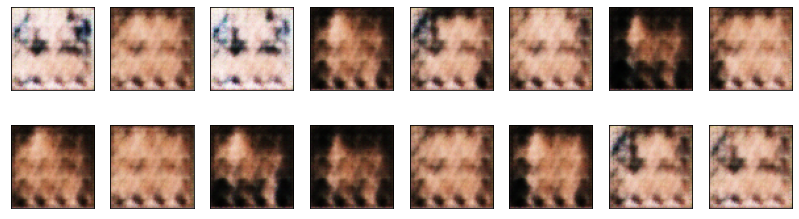

2023-11-02 18:16:51 | Epoch [7/60] | Batch 0/509 | d_loss: -226.6752 | g_loss: 503.2372
2023-11-02 18:16:58 | Epoch [7/60] | Batch 50/509 | d_loss: -399.3777 | g_loss: -1037.4911
2023-11-02 18:17:06 | Epoch [7/60] | Batch 100/509 | d_loss: -813.6531 | g_loss: -2672.5073
2023-11-02 18:17:13 | Epoch [7/60] | Batch 150/509 | d_loss: -390.7824 | g_loss: 1670.9329
2023-11-02 18:17:21 | Epoch [7/60] | Batch 200/509 | d_loss: -302.0893 | g_loss: -1050.8518
2023-11-02 18:17:28 | Epoch [7/60] | Batch 250/509 | d_loss: -333.9093 | g_loss: 1978.8217
2023-11-02 18:17:36 | Epoch [7/60] | Batch 300/509 | d_loss: -502.9728 | g_loss: 4899.9800
2023-11-02 18:17:43 | Epoch [7/60] | Batch 350/509 | d_loss: -241.2736 | g_loss: 821.9852
2023-11-02 18:17:51 | Epoch [7/60] | Batch 400/509 | d_loss: -447.7369 | g_loss: 1916.0006
2023-11-02 18:17:59 | Epoch [7/60] | Batch 450/509 | d_loss: -298.7585 | g_loss: 250.7608
2023-11-02 18:18:06 | Epoch [7/60] | Batch 500/509 | d_loss: -630.7391 | g_loss: -4147.9805


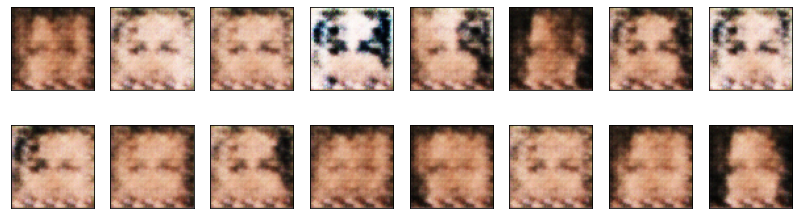

2023-11-02 18:18:12 | Epoch [8/60] | Batch 0/509 | d_loss: -512.9972 | g_loss: 2831.6821
2023-11-02 18:18:19 | Epoch [8/60] | Batch 50/509 | d_loss: -336.5526 | g_loss: -2301.9897
2023-11-02 18:18:27 | Epoch [8/60] | Batch 100/509 | d_loss: 51.5116 | g_loss: -4695.3164
2023-11-02 18:18:34 | Epoch [8/60] | Batch 150/509 | d_loss: -362.6299 | g_loss: 2484.5964
2023-11-02 18:18:42 | Epoch [8/60] | Batch 200/509 | d_loss: -319.2382 | g_loss: 313.4200
2023-11-02 18:18:49 | Epoch [8/60] | Batch 250/509 | d_loss: -442.6430 | g_loss: 2047.3192
2023-11-02 18:18:57 | Epoch [8/60] | Batch 300/509 | d_loss: -343.2689 | g_loss: 377.3203
2023-11-02 18:19:04 | Epoch [8/60] | Batch 350/509 | d_loss: -429.0264 | g_loss: 625.1932
2023-11-02 18:19:12 | Epoch [8/60] | Batch 400/509 | d_loss: -352.1401 | g_loss: 1186.2191
2023-11-02 18:19:19 | Epoch [8/60] | Batch 450/509 | d_loss: -43.0265 | g_loss: 97.4286
2023-11-02 18:19:27 | Epoch [8/60] | Batch 500/509 | d_loss: -298.9675 | g_loss: -2132.6580
2023-11

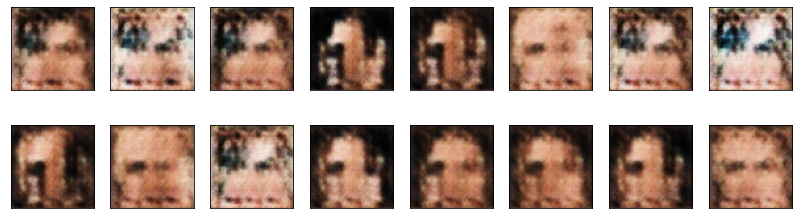

2023-11-02 18:20:53 | Epoch [10/60] | Batch 0/509 | d_loss: -297.0937 | g_loss: -4049.2222
2023-11-02 18:21:01 | Epoch [10/60] | Batch 50/509 | d_loss: -198.4466 | g_loss: -1579.2683
2023-11-02 18:21:08 | Epoch [10/60] | Batch 100/509 | d_loss: -313.0574 | g_loss: -1704.3783
2023-11-02 18:21:16 | Epoch [10/60] | Batch 150/509 | d_loss: -371.5544 | g_loss: -5509.4048
2023-11-02 18:21:23 | Epoch [10/60] | Batch 200/509 | d_loss: -472.9832 | g_loss: 2277.0059
2023-11-02 18:21:31 | Epoch [10/60] | Batch 250/509 | d_loss: -340.7719 | g_loss: -2188.2117
2023-11-02 18:21:38 | Epoch [10/60] | Batch 300/509 | d_loss: -357.7051 | g_loss: -1335.2522
2023-11-02 18:21:46 | Epoch [10/60] | Batch 350/509 | d_loss: -494.1585 | g_loss: -2805.2393
2023-11-02 18:21:54 | Epoch [10/60] | Batch 400/509 | d_loss: -386.3527 | g_loss: -3981.6633
2023-11-02 18:22:01 | Epoch [10/60] | Batch 450/509 | d_loss: -345.9062 | g_loss: -1283.9441
2023-11-02 18:22:09 | Epoch [10/60] | Batch 500/509 | d_loss: -506.1578 | 

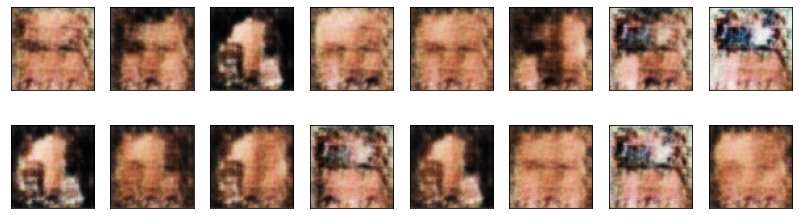

2023-11-02 18:22:14 | Epoch [11/60] | Batch 0/509 | d_loss: -464.9186 | g_loss: -2210.4614
2023-11-02 18:22:22 | Epoch [11/60] | Batch 50/509 | d_loss: -497.9936 | g_loss: -4409.1592
2023-11-02 18:22:29 | Epoch [11/60] | Batch 100/509 | d_loss: -628.7723 | g_loss: -2869.0200
2023-11-02 18:22:37 | Epoch [11/60] | Batch 150/509 | d_loss: -420.6041 | g_loss: -3945.7476
2023-11-02 18:22:44 | Epoch [11/60] | Batch 200/509 | d_loss: -376.8530 | g_loss: -1102.5361
2023-11-02 18:22:52 | Epoch [11/60] | Batch 250/509 | d_loss: -560.7267 | g_loss: -3778.1167
2023-11-02 18:22:59 | Epoch [11/60] | Batch 300/509 | d_loss: -398.8201 | g_loss: -4189.7144
2023-11-02 18:23:07 | Epoch [11/60] | Batch 350/509 | d_loss: -358.7217 | g_loss: -8205.6797
2023-11-02 18:23:14 | Epoch [11/60] | Batch 400/509 | d_loss: -555.7972 | g_loss: -5456.1909
2023-11-02 18:23:22 | Epoch [11/60] | Batch 450/509 | d_loss: -341.2056 | g_loss: -5372.2002
2023-11-02 18:23:29 | Epoch [11/60] | Batch 500/509 | d_loss: -397.6391 |

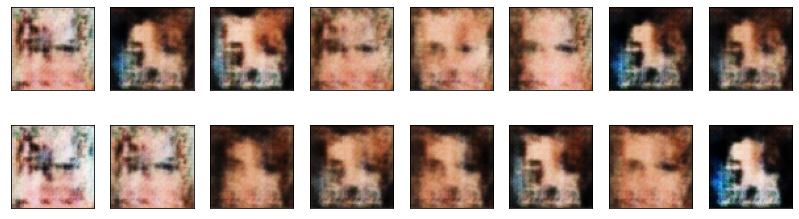

2023-11-02 18:23:34 | Epoch [12/60] | Batch 0/509 | d_loss: -419.3167 | g_loss: -1798.0349
2023-11-02 18:23:42 | Epoch [12/60] | Batch 50/509 | d_loss: -337.6132 | g_loss: -5758.5205
2023-11-02 18:23:49 | Epoch [12/60] | Batch 100/509 | d_loss: -276.8673 | g_loss: -4632.5596
2023-11-02 18:23:57 | Epoch [12/60] | Batch 150/509 | d_loss: -500.6910 | g_loss: -9034.9678
2023-11-02 18:24:05 | Epoch [12/60] | Batch 200/509 | d_loss: -403.4086 | g_loss: -7516.1753
2023-11-02 18:24:12 | Epoch [12/60] | Batch 250/509 | d_loss: -254.0210 | g_loss: -7900.1533
2023-11-02 18:24:20 | Epoch [12/60] | Batch 300/509 | d_loss: -455.6856 | g_loss: -6641.6987
2023-11-02 18:24:27 | Epoch [12/60] | Batch 350/509 | d_loss: 13.0203 | g_loss: -4230.3105
2023-11-02 18:24:35 | Epoch [12/60] | Batch 400/509 | d_loss: -384.7838 | g_loss: -6296.7505
2023-11-02 18:24:42 | Epoch [12/60] | Batch 450/509 | d_loss: -368.1967 | g_loss: -7692.7891
2023-11-02 18:24:50 | Epoch [12/60] | Batch 500/509 | d_loss: -266.7509 | g

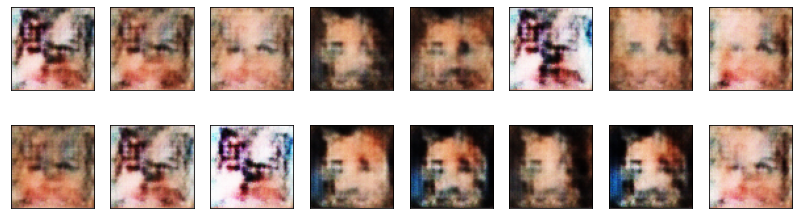

2023-11-02 18:24:55 | Epoch [13/60] | Batch 0/509 | d_loss: -256.9720 | g_loss: -7496.8555
2023-11-02 18:25:02 | Epoch [13/60] | Batch 50/509 | d_loss: -379.1859 | g_loss: -8888.8252
2023-11-02 18:25:10 | Epoch [13/60] | Batch 100/509 | d_loss: -283.2824 | g_loss: -6729.1763
2023-11-02 18:25:17 | Epoch [13/60] | Batch 150/509 | d_loss: -143.3419 | g_loss: -9744.6582
2023-11-02 18:25:25 | Epoch [13/60] | Batch 200/509 | d_loss: -290.0001 | g_loss: -7427.4326
2023-11-02 18:25:32 | Epoch [13/60] | Batch 250/509 | d_loss: -399.7533 | g_loss: -6780.4126
2023-11-02 18:25:40 | Epoch [13/60] | Batch 300/509 | d_loss: -358.6119 | g_loss: -7487.3145
2023-11-02 18:25:48 | Epoch [13/60] | Batch 350/509 | d_loss: -304.8944 | g_loss: -6807.6494
2023-11-02 18:25:55 | Epoch [13/60] | Batch 400/509 | d_loss: -245.5715 | g_loss: -8460.5352
2023-11-02 18:26:03 | Epoch [13/60] | Batch 450/509 | d_loss: -175.6652 | g_loss: -7774.3975
2023-11-02 18:26:10 | Epoch [13/60] | Batch 500/509 | d_loss: -205.7061 |

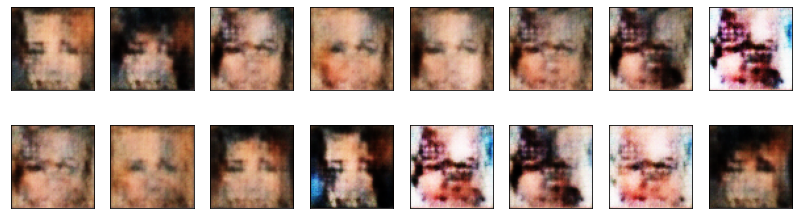

2023-11-02 18:26:16 | Epoch [14/60] | Batch 0/509 | d_loss: -196.9149 | g_loss: -8786.2324
2023-11-02 18:26:24 | Epoch [14/60] | Batch 50/509 | d_loss: -275.7372 | g_loss: -8339.3008
2023-11-02 18:26:31 | Epoch [14/60] | Batch 100/509 | d_loss: -307.1913 | g_loss: -5489.9556
2023-11-02 18:26:39 | Epoch [14/60] | Batch 150/509 | d_loss: -256.1105 | g_loss: -7811.6753
2023-11-02 18:26:46 | Epoch [14/60] | Batch 200/509 | d_loss: -272.5184 | g_loss: -6258.7402
2023-11-02 18:26:54 | Epoch [14/60] | Batch 250/509 | d_loss: -160.1964 | g_loss: -4526.1992
2023-11-02 18:27:01 | Epoch [14/60] | Batch 300/509 | d_loss: -248.3703 | g_loss: -4655.6621
2023-11-02 18:27:09 | Epoch [14/60] | Batch 350/509 | d_loss: -432.1010 | g_loss: -3876.0679
2023-11-02 18:27:16 | Epoch [14/60] | Batch 400/509 | d_loss: -152.4432 | g_loss: -5922.8516
2023-11-02 18:27:24 | Epoch [14/60] | Batch 450/509 | d_loss: -277.3683 | g_loss: -7766.7285
2023-11-02 18:27:31 | Epoch [14/60] | Batch 500/509 | d_loss: -448.5993 |

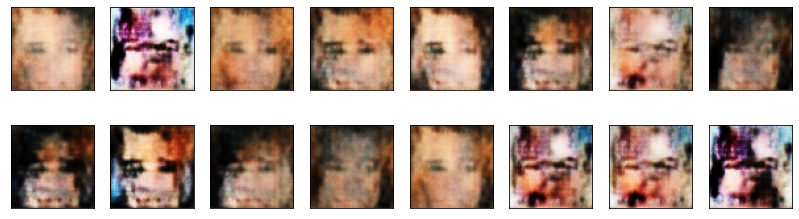

2023-11-02 18:27:36 | Epoch [15/60] | Batch 0/509 | d_loss: -447.7018 | g_loss: -5038.4224
2023-11-02 18:27:44 | Epoch [15/60] | Batch 50/509 | d_loss: -244.2756 | g_loss: -3236.8662
2023-11-02 18:27:51 | Epoch [15/60] | Batch 100/509 | d_loss: -327.0702 | g_loss: -10039.4609
2023-11-02 18:27:59 | Epoch [15/60] | Batch 150/509 | d_loss: -202.1235 | g_loss: -4977.8457
2023-11-02 18:28:06 | Epoch [15/60] | Batch 200/509 | d_loss: -227.4731 | g_loss: -2594.2961
2023-11-02 18:28:14 | Epoch [15/60] | Batch 250/509 | d_loss: -190.5474 | g_loss: -2877.3579
2023-11-02 18:28:21 | Epoch [15/60] | Batch 300/509 | d_loss: -168.6861 | g_loss: -4461.5625
2023-11-02 18:28:29 | Epoch [15/60] | Batch 350/509 | d_loss: -153.0303 | g_loss: -4067.2380
2023-11-02 18:28:36 | Epoch [15/60] | Batch 400/509 | d_loss: -290.7174 | g_loss: -6754.6987
2023-11-02 18:28:44 | Epoch [15/60] | Batch 450/509 | d_loss: -232.2533 | g_loss: -6764.8809
2023-11-02 18:28:51 | Epoch [15/60] | Batch 500/509 | d_loss: -245.8418 

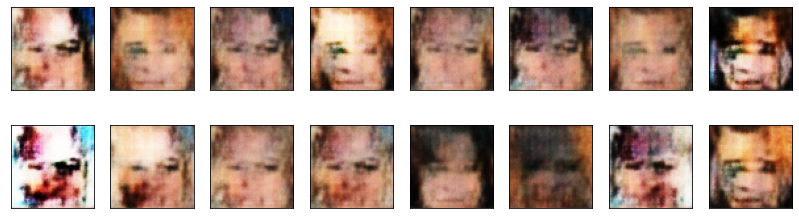

2023-11-02 18:28:57 | Epoch [16/60] | Batch 0/509 | d_loss: -239.5100 | g_loss: -1322.4529
2023-11-02 18:29:05 | Epoch [16/60] | Batch 50/509 | d_loss: -223.0970 | g_loss: -5361.5342
2023-11-02 18:29:12 | Epoch [16/60] | Batch 100/509 | d_loss: -107.2029 | g_loss: -4375.0479
2023-11-02 18:29:20 | Epoch [16/60] | Batch 150/509 | d_loss: -198.8791 | g_loss: -6215.7437
2023-11-02 18:29:27 | Epoch [16/60] | Batch 200/509 | d_loss: -244.6898 | g_loss: -2710.7202
2023-11-02 18:29:35 | Epoch [16/60] | Batch 250/509 | d_loss: -173.3153 | g_loss: -6782.6675
2023-11-02 18:29:42 | Epoch [16/60] | Batch 300/509 | d_loss: -155.5103 | g_loss: -2759.4888
2023-11-02 18:29:50 | Epoch [16/60] | Batch 350/509 | d_loss: -276.7062 | g_loss: -6244.9326
2023-11-02 18:29:57 | Epoch [16/60] | Batch 400/509 | d_loss: 126.0867 | g_loss: -1762.5264
2023-11-02 18:30:05 | Epoch [16/60] | Batch 450/509 | d_loss: -61.4055 | g_loss: -1942.3263
2023-11-02 18:30:12 | Epoch [16/60] | Batch 500/509 | d_loss: -86.1919 | g_

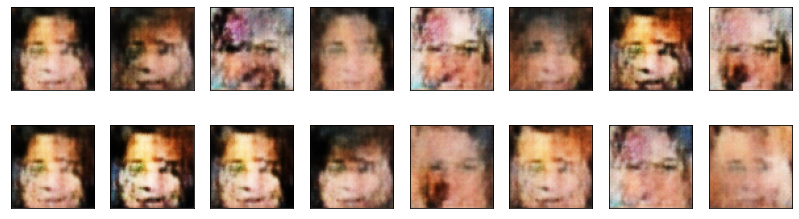

2023-11-02 18:30:17 | Epoch [17/60] | Batch 0/509 | d_loss: 16.4441 | g_loss: -4368.8066
2023-11-02 18:30:25 | Epoch [17/60] | Batch 50/509 | d_loss: -337.4260 | g_loss: -2137.5220
2023-11-02 18:30:32 | Epoch [17/60] | Batch 100/509 | d_loss: -336.0826 | g_loss: -3734.2644
2023-11-02 18:30:40 | Epoch [17/60] | Batch 150/509 | d_loss: -89.8630 | g_loss: -1798.7097
2023-11-02 18:30:47 | Epoch [17/60] | Batch 200/509 | d_loss: -225.4908 | g_loss: -5609.1318
2023-11-02 18:30:55 | Epoch [17/60] | Batch 250/509 | d_loss: -171.8476 | g_loss: -4204.5664
2023-11-02 18:31:02 | Epoch [17/60] | Batch 300/509 | d_loss: -208.0970 | g_loss: -2619.2026
2023-11-02 18:31:10 | Epoch [17/60] | Batch 350/509 | d_loss: -173.6171 | g_loss: -5076.8062
2023-11-02 18:31:17 | Epoch [17/60] | Batch 400/509 | d_loss: -155.6422 | g_loss: -3282.5691
2023-11-02 18:31:25 | Epoch [17/60] | Batch 450/509 | d_loss: -209.9023 | g_loss: -982.0120
2023-11-02 18:31:32 | Epoch [17/60] | Batch 500/509 | d_loss: -171.5602 | g_l

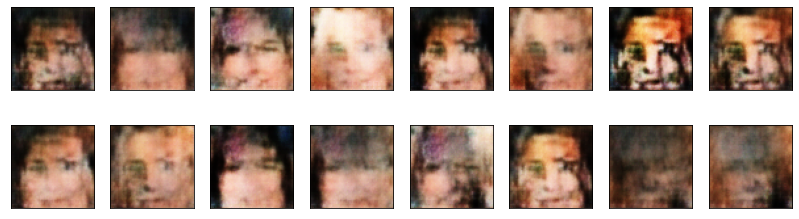

2023-11-02 18:31:38 | Epoch [18/60] | Batch 0/509 | d_loss: -133.3996 | g_loss: -3302.7734
2023-11-02 18:31:46 | Epoch [18/60] | Batch 50/509 | d_loss: -112.6790 | g_loss: -4562.1514
2023-11-02 18:31:53 | Epoch [18/60] | Batch 100/509 | d_loss: -145.8180 | g_loss: -2669.7466
2023-11-02 18:32:01 | Epoch [18/60] | Batch 150/509 | d_loss: -122.5427 | g_loss: -5201.2671
2023-11-02 18:32:08 | Epoch [18/60] | Batch 200/509 | d_loss: -313.4325 | g_loss: -337.4672
2023-11-02 18:32:16 | Epoch [18/60] | Batch 250/509 | d_loss: -5.3997 | g_loss: -2075.0732
2023-11-02 18:32:23 | Epoch [18/60] | Batch 300/509 | d_loss: -110.2708 | g_loss: -3623.4751
2023-11-02 18:32:31 | Epoch [18/60] | Batch 350/509 | d_loss: -142.2476 | g_loss: -4017.7319
2023-11-02 18:32:38 | Epoch [18/60] | Batch 400/509 | d_loss: -227.4075 | g_loss: -4399.5645
2023-11-02 18:32:46 | Epoch [18/60] | Batch 450/509 | d_loss: -185.0601 | g_loss: -1873.7646
2023-11-02 18:32:54 | Epoch [18/60] | Batch 500/509 | d_loss: -151.4442 | g_

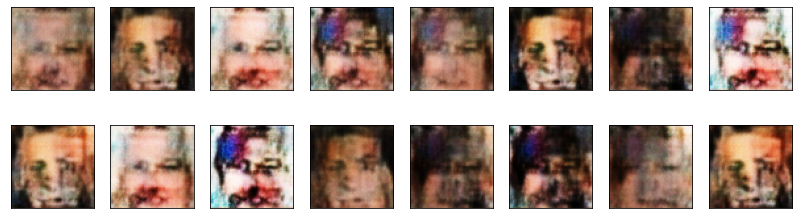

2023-11-02 18:32:59 | Epoch [19/60] | Batch 0/509 | d_loss: -216.2915 | g_loss: -3147.1824
2023-11-02 18:33:07 | Epoch [19/60] | Batch 50/509 | d_loss: -168.2131 | g_loss: -2205.2668
2023-11-02 18:33:14 | Epoch [19/60] | Batch 100/509 | d_loss: -188.1006 | g_loss: -2754.3518
2023-11-02 18:33:22 | Epoch [19/60] | Batch 150/509 | d_loss: -207.4156 | g_loss: -5254.2539
2023-11-02 18:33:29 | Epoch [19/60] | Batch 200/509 | d_loss: -201.6691 | g_loss: -4542.3223
2023-11-02 18:33:37 | Epoch [19/60] | Batch 250/509 | d_loss: -192.7150 | g_loss: -4790.8643
2023-11-02 18:33:44 | Epoch [19/60] | Batch 300/509 | d_loss: -136.4728 | g_loss: -3107.7222
2023-11-02 18:33:52 | Epoch [19/60] | Batch 350/509 | d_loss: -223.3350 | g_loss: -4052.7756
2023-11-02 18:33:59 | Epoch [19/60] | Batch 400/509 | d_loss: -203.0300 | g_loss: -3764.4109
2023-11-02 18:34:07 | Epoch [19/60] | Batch 450/509 | d_loss: -220.4739 | g_loss: -559.7384
2023-11-02 18:34:14 | Epoch [19/60] | Batch 500/509 | d_loss: -199.9623 | 

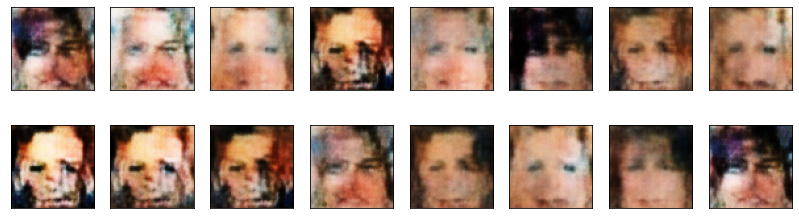

2023-11-02 18:34:20 | Epoch [20/60] | Batch 0/509 | d_loss: -107.2307 | g_loss: -5149.7432
2023-11-02 18:34:28 | Epoch [20/60] | Batch 50/509 | d_loss: -156.7438 | g_loss: -383.1653
2023-11-02 18:34:35 | Epoch [20/60] | Batch 100/509 | d_loss: -228.1504 | g_loss: -3172.3230
2023-11-02 18:34:43 | Epoch [20/60] | Batch 150/509 | d_loss: -179.6960 | g_loss: -2646.2275
2023-11-02 18:34:50 | Epoch [20/60] | Batch 200/509 | d_loss: -132.5258 | g_loss: -3265.4204
2023-11-02 18:34:58 | Epoch [20/60] | Batch 250/509 | d_loss: -160.9330 | g_loss: -2816.0444
2023-11-02 18:35:05 | Epoch [20/60] | Batch 300/509 | d_loss: -164.9795 | g_loss: -3217.1873
2023-11-02 18:35:13 | Epoch [20/60] | Batch 350/509 | d_loss: -289.4940 | g_loss: -4506.7109
2023-11-02 18:35:20 | Epoch [20/60] | Batch 400/509 | d_loss: -224.0140 | g_loss: -2058.6021
2023-11-02 18:35:28 | Epoch [20/60] | Batch 450/509 | d_loss: -159.4435 | g_loss: -1860.7810
2023-11-02 18:35:35 | Epoch [20/60] | Batch 500/509 | d_loss: -151.7532 | 

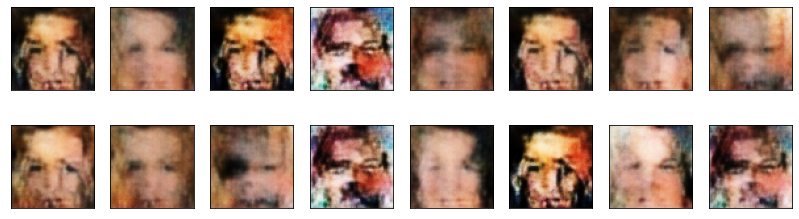

2023-11-02 18:35:40 | Epoch [21/60] | Batch 0/509 | d_loss: -188.2092 | g_loss: -3779.9441
2023-11-02 18:35:48 | Epoch [21/60] | Batch 50/509 | d_loss: -330.3437 | g_loss: -1988.8210
2023-11-02 18:35:55 | Epoch [21/60] | Batch 100/509 | d_loss: -178.6521 | g_loss: -3561.2256
2023-11-02 18:36:03 | Epoch [21/60] | Batch 150/509 | d_loss: -145.9759 | g_loss: -3768.5513
2023-11-02 18:36:10 | Epoch [21/60] | Batch 200/509 | d_loss: -189.1683 | g_loss: -3050.5264
2023-11-02 18:36:18 | Epoch [21/60] | Batch 250/509 | d_loss: -187.4128 | g_loss: -1001.4830
2023-11-02 18:36:25 | Epoch [21/60] | Batch 300/509 | d_loss: -177.6457 | g_loss: -2952.0610
2023-11-02 18:36:33 | Epoch [21/60] | Batch 350/509 | d_loss: -167.8937 | g_loss: -3811.2739
2023-11-02 18:36:40 | Epoch [21/60] | Batch 400/509 | d_loss: -166.6160 | g_loss: -3947.0137
2023-11-02 18:36:48 | Epoch [21/60] | Batch 450/509 | d_loss: -207.4523 | g_loss: -4760.4395
2023-11-02 18:36:55 | Epoch [21/60] | Batch 500/509 | d_loss: -124.0964 |

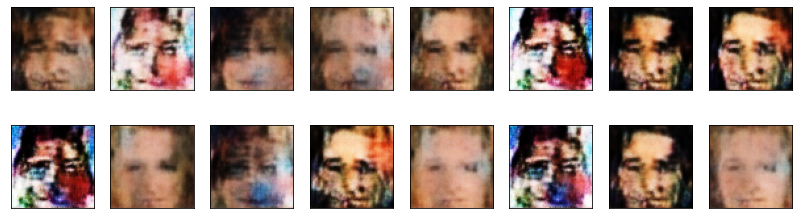

2023-11-02 18:37:00 | Epoch [22/60] | Batch 0/509 | d_loss: -131.7453 | g_loss: -2777.0310
2023-11-02 18:37:08 | Epoch [22/60] | Batch 50/509 | d_loss: -143.0410 | g_loss: -1208.7900
2023-11-02 18:37:16 | Epoch [22/60] | Batch 100/509 | d_loss: -216.6806 | g_loss: 114.4268
2023-11-02 18:37:23 | Epoch [22/60] | Batch 150/509 | d_loss: -176.7690 | g_loss: -2901.5186
2023-11-02 18:37:31 | Epoch [22/60] | Batch 200/509 | d_loss: -236.5487 | g_loss: -2468.4536
2023-11-02 18:37:38 | Epoch [22/60] | Batch 250/509 | d_loss: -223.2694 | g_loss: -4032.8542
2023-11-02 18:37:46 | Epoch [22/60] | Batch 300/509 | d_loss: -156.6353 | g_loss: -3626.2515
2023-11-02 18:37:53 | Epoch [22/60] | Batch 350/509 | d_loss: -165.4632 | g_loss: -3567.9390
2023-11-02 18:38:01 | Epoch [22/60] | Batch 400/509 | d_loss: -181.3934 | g_loss: -2898.7681
2023-11-02 18:38:09 | Epoch [22/60] | Batch 450/509 | d_loss: -189.9538 | g_loss: -3949.0039
2023-11-02 18:38:17 | Epoch [22/60] | Batch 500/509 | d_loss: -222.5040 | g

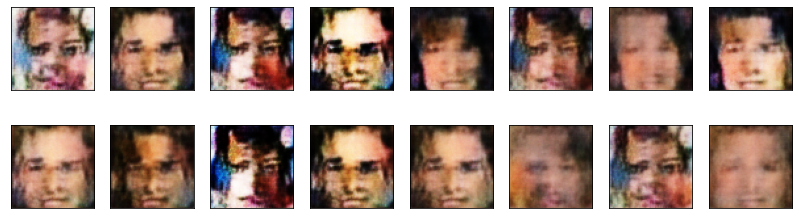

2023-11-02 18:38:22 | Epoch [23/60] | Batch 0/509 | d_loss: -182.4339 | g_loss: -2978.6990
2023-11-02 18:38:31 | Epoch [23/60] | Batch 50/509 | d_loss: -143.8679 | g_loss: -3944.5115
2023-11-02 18:38:39 | Epoch [23/60] | Batch 100/509 | d_loss: -135.2661 | g_loss: -4378.1924
2023-11-02 18:38:48 | Epoch [23/60] | Batch 150/509 | d_loss: -148.8435 | g_loss: -1512.6709
2023-11-02 18:38:57 | Epoch [23/60] | Batch 200/509 | d_loss: -96.5890 | g_loss: -1208.4122
2023-11-02 18:39:06 | Epoch [23/60] | Batch 250/509 | d_loss: -163.1914 | g_loss: -3756.3369
2023-11-02 18:39:15 | Epoch [23/60] | Batch 300/509 | d_loss: -178.8751 | g_loss: -3525.6301
2023-11-02 18:39:23 | Epoch [23/60] | Batch 350/509 | d_loss: -155.8592 | g_loss: -2006.7849
2023-11-02 18:39:31 | Epoch [23/60] | Batch 400/509 | d_loss: -146.2493 | g_loss: -2425.6472
2023-11-02 18:39:38 | Epoch [23/60] | Batch 450/509 | d_loss: -174.3042 | g_loss: -1486.8547
2023-11-02 18:39:46 | Epoch [23/60] | Batch 500/509 | d_loss: -163.9168 | 

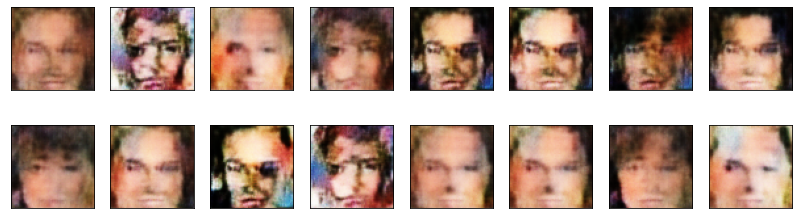

2023-11-02 18:39:50 | Epoch [24/60] | Batch 0/509 | d_loss: -196.7652 | g_loss: -3233.1821
2023-11-02 18:39:59 | Epoch [24/60] | Batch 50/509 | d_loss: -195.3945 | g_loss: -3176.3337
2023-11-02 18:40:07 | Epoch [24/60] | Batch 100/509 | d_loss: 39.9761 | g_loss: -2465.9922
2023-11-02 18:40:16 | Epoch [24/60] | Batch 150/509 | d_loss: -168.8619 | g_loss: -3465.9370
2023-11-02 18:40:25 | Epoch [24/60] | Batch 200/509 | d_loss: -176.4173 | g_loss: -1224.4922
2023-11-02 18:40:34 | Epoch [24/60] | Batch 250/509 | d_loss: -66.6333 | g_loss: -3722.4648
2023-11-02 18:40:43 | Epoch [24/60] | Batch 300/509 | d_loss: -114.3917 | g_loss: -632.2407
2023-11-02 18:40:52 | Epoch [24/60] | Batch 350/509 | d_loss: -160.4416 | g_loss: -2575.6289
2023-11-02 18:41:00 | Epoch [24/60] | Batch 400/509 | d_loss: -139.9964 | g_loss: -1441.9722
2023-11-02 18:41:08 | Epoch [24/60] | Batch 450/509 | d_loss: -133.8194 | g_loss: -4108.5669
2023-11-02 18:41:16 | Epoch [24/60] | Batch 500/509 | d_loss: -152.5649 | g_l

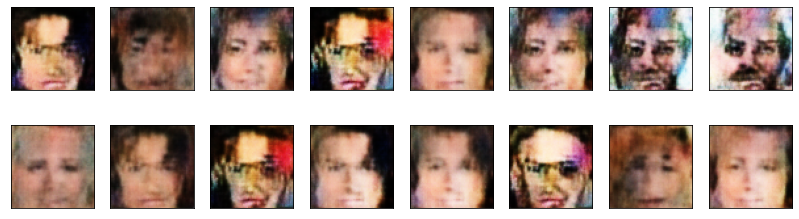

2023-11-02 18:41:20 | Epoch [25/60] | Batch 0/509 | d_loss: -87.7581 | g_loss: -4366.0430
2023-11-02 18:41:29 | Epoch [25/60] | Batch 50/509 | d_loss: -225.2343 | g_loss: -5170.5557
2023-11-02 18:41:37 | Epoch [25/60] | Batch 100/509 | d_loss: -128.8307 | g_loss: -3431.5740
2023-11-02 18:41:46 | Epoch [25/60] | Batch 150/509 | d_loss: -121.1223 | g_loss: -2106.3799
2023-11-02 18:41:55 | Epoch [25/60] | Batch 200/509 | d_loss: -145.6594 | g_loss: -3390.4070
2023-11-02 18:42:04 | Epoch [25/60] | Batch 250/509 | d_loss: -105.8381 | g_loss: -3887.1665
2023-11-02 18:42:12 | Epoch [25/60] | Batch 300/509 | d_loss: -156.0597 | g_loss: -2242.7354
2023-11-02 18:42:21 | Epoch [25/60] | Batch 350/509 | d_loss: -132.7678 | g_loss: -2038.0376
2023-11-02 18:42:29 | Epoch [25/60] | Batch 400/509 | d_loss: -89.7727 | g_loss: -2497.3027
2023-11-02 18:42:38 | Epoch [25/60] | Batch 450/509 | d_loss: -192.6242 | g_loss: -281.1882
2023-11-02 18:42:46 | Epoch [25/60] | Batch 500/509 | d_loss: -153.4585 | g_

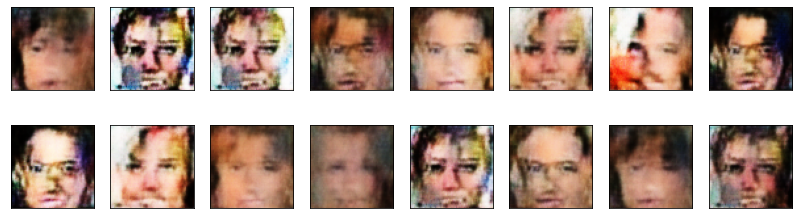

2023-11-02 18:42:51 | Epoch [26/60] | Batch 0/509 | d_loss: -117.8669 | g_loss: -2568.9834
2023-11-02 18:42:59 | Epoch [26/60] | Batch 50/509 | d_loss: -150.9645 | g_loss: -1169.6577
2023-11-02 18:43:08 | Epoch [26/60] | Batch 100/509 | d_loss: -103.0278 | g_loss: -2108.6978
2023-11-02 18:43:17 | Epoch [26/60] | Batch 150/509 | d_loss: -117.6660 | g_loss: -1160.0164
2023-11-02 18:43:25 | Epoch [26/60] | Batch 200/509 | d_loss: -164.0659 | g_loss: -3164.8228
2023-11-02 18:43:34 | Epoch [26/60] | Batch 250/509 | d_loss: -140.0457 | g_loss: -3481.2566
2023-11-02 18:43:43 | Epoch [26/60] | Batch 300/509 | d_loss: -141.7576 | g_loss: -2858.5137
2023-11-02 18:43:52 | Epoch [26/60] | Batch 350/509 | d_loss: -169.5092 | g_loss: -4449.1309
2023-11-02 18:44:00 | Epoch [26/60] | Batch 400/509 | d_loss: -125.6170 | g_loss: -3709.2517
2023-11-02 18:44:09 | Epoch [26/60] | Batch 450/509 | d_loss: -14.5161 | g_loss: -3472.8682
2023-11-02 18:44:17 | Epoch [26/60] | Batch 500/509 | d_loss: -112.1044 | 

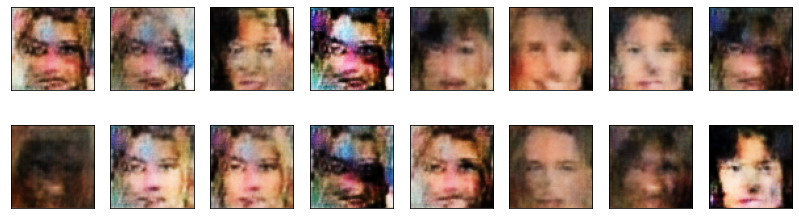

2023-11-02 18:44:23 | Epoch [27/60] | Batch 0/509 | d_loss: -80.0450 | g_loss: -3605.9041
2023-11-02 18:44:30 | Epoch [27/60] | Batch 50/509 | d_loss: -124.2845 | g_loss: -2745.1846
2023-11-02 18:44:39 | Epoch [27/60] | Batch 100/509 | d_loss: -169.5262 | g_loss: -3401.3718
2023-11-02 18:44:48 | Epoch [27/60] | Batch 150/509 | d_loss: -141.6010 | g_loss: -3263.7065
2023-11-02 18:44:57 | Epoch [27/60] | Batch 200/509 | d_loss: -184.5286 | g_loss: -4695.7212
2023-11-02 18:45:05 | Epoch [27/60] | Batch 250/509 | d_loss: -169.3230 | g_loss: -3092.6321
2023-11-02 18:45:14 | Epoch [27/60] | Batch 300/509 | d_loss: -146.8160 | g_loss: -4598.9707
2023-11-02 18:45:22 | Epoch [27/60] | Batch 350/509 | d_loss: -95.8060 | g_loss: -3501.8569
2023-11-02 18:45:31 | Epoch [27/60] | Batch 400/509 | d_loss: -125.1224 | g_loss: -2060.3352
2023-11-02 18:45:40 | Epoch [27/60] | Batch 450/509 | d_loss: -167.3606 | g_loss: -3431.8120
2023-11-02 18:45:48 | Epoch [27/60] | Batch 500/509 | d_loss: -153.1805 | g

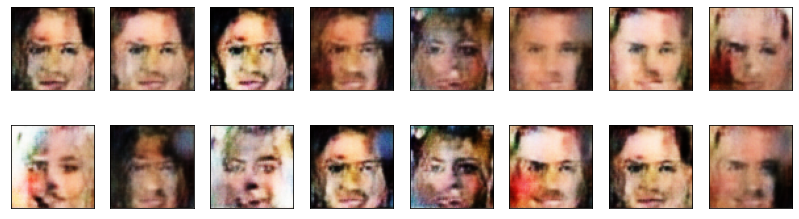

2023-11-02 18:45:54 | Epoch [28/60] | Batch 0/509 | d_loss: -127.8450 | g_loss: -3450.3672
2023-11-02 18:46:02 | Epoch [28/60] | Batch 50/509 | d_loss: -155.8807 | g_loss: -3809.1758
2023-11-02 18:46:10 | Epoch [28/60] | Batch 100/509 | d_loss: -156.4009 | g_loss: -4063.5222
2023-11-02 18:46:19 | Epoch [28/60] | Batch 150/509 | d_loss: -141.6317 | g_loss: -2868.0066
2023-11-02 18:46:28 | Epoch [28/60] | Batch 200/509 | d_loss: -178.3066 | g_loss: -3960.4136
2023-11-02 18:46:36 | Epoch [28/60] | Batch 250/509 | d_loss: -29.4102 | g_loss: -2878.1611
2023-11-02 18:46:45 | Epoch [28/60] | Batch 300/509 | d_loss: -117.3956 | g_loss: -2994.8325
2023-11-02 18:46:54 | Epoch [28/60] | Batch 350/509 | d_loss: -116.5978 | g_loss: -1609.0779
2023-11-02 18:47:03 | Epoch [28/60] | Batch 400/509 | d_loss: -115.9307 | g_loss: -1751.5125
2023-11-02 18:47:11 | Epoch [28/60] | Batch 450/509 | d_loss: -88.9211 | g_loss: -2497.7329
2023-11-02 18:47:19 | Epoch [28/60] | Batch 500/509 | d_loss: -117.1694 | g

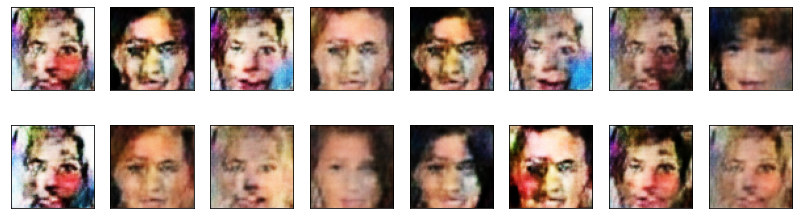

2023-11-02 18:47:25 | Epoch [29/60] | Batch 0/509 | d_loss: -144.9431 | g_loss: -3368.6226
2023-11-02 18:47:33 | Epoch [29/60] | Batch 50/509 | d_loss: -186.9047 | g_loss: -3288.7646
2023-11-02 18:47:41 | Epoch [29/60] | Batch 100/509 | d_loss: -136.5702 | g_loss: -1375.1182
2023-11-02 18:47:50 | Epoch [29/60] | Batch 150/509 | d_loss: -152.3454 | g_loss: -2637.7563
2023-11-02 18:47:59 | Epoch [29/60] | Batch 200/509 | d_loss: -180.9560 | g_loss: -4109.9238
2023-11-02 18:48:08 | Epoch [29/60] | Batch 250/509 | d_loss: -159.3793 | g_loss: -2900.2578
2023-11-02 18:48:16 | Epoch [29/60] | Batch 300/509 | d_loss: -170.6599 | g_loss: -1890.7104
2023-11-02 18:48:25 | Epoch [29/60] | Batch 350/509 | d_loss: -84.0761 | g_loss: -2185.6338
2023-11-02 18:48:33 | Epoch [29/60] | Batch 400/509 | d_loss: -156.9206 | g_loss: -1671.7219
2023-11-02 18:48:42 | Epoch [29/60] | Batch 450/509 | d_loss: -228.7620 | g_loss: -1343.0096
2023-11-02 18:48:51 | Epoch [29/60] | Batch 500/509 | d_loss: -95.4370 | g

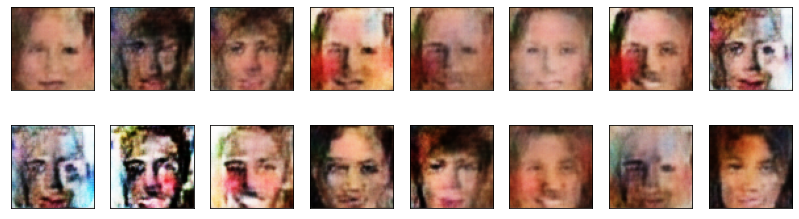

2023-11-02 18:48:56 | Epoch [30/60] | Batch 0/509 | d_loss: -107.5677 | g_loss: -1004.9852
2023-11-02 18:49:04 | Epoch [30/60] | Batch 50/509 | d_loss: -143.0408 | g_loss: -2804.7341
2023-11-02 18:49:11 | Epoch [30/60] | Batch 100/509 | d_loss: -69.1477 | g_loss: -3138.9109
2023-11-02 18:49:20 | Epoch [30/60] | Batch 150/509 | d_loss: -95.6479 | g_loss: -2394.8965
2023-11-02 18:49:29 | Epoch [30/60] | Batch 200/509 | d_loss: -209.6801 | g_loss: -3579.1401
2023-11-02 18:49:38 | Epoch [30/60] | Batch 250/509 | d_loss: -137.8644 | g_loss: -2088.2405
2023-11-02 18:49:46 | Epoch [30/60] | Batch 300/509 | d_loss: -136.5865 | g_loss: -3012.0850
2023-11-02 18:49:55 | Epoch [30/60] | Batch 350/509 | d_loss: -111.3896 | g_loss: -2556.8604
2023-11-02 18:50:04 | Epoch [30/60] | Batch 400/509 | d_loss: -116.3860 | g_loss: -1438.1589
2023-11-02 18:50:12 | Epoch [30/60] | Batch 450/509 | d_loss: -134.4570 | g_loss: -2435.0757
2023-11-02 18:50:21 | Epoch [30/60] | Batch 500/509 | d_loss: -157.4194 | g

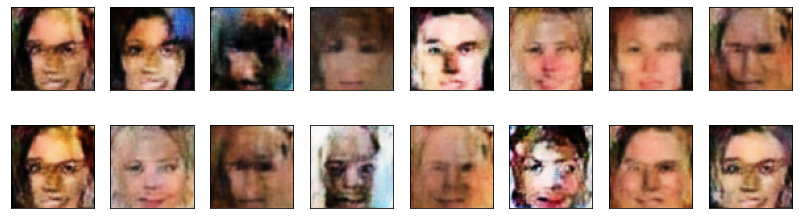

2023-11-02 18:50:28 | Epoch [31/60] | Batch 0/509 | d_loss: -125.6448 | g_loss: -2655.1128
2023-11-02 18:50:35 | Epoch [31/60] | Batch 50/509 | d_loss: -130.8688 | g_loss: -1930.8224
2023-11-02 18:50:43 | Epoch [31/60] | Batch 100/509 | d_loss: -138.9501 | g_loss: -2423.8979
2023-11-02 18:50:52 | Epoch [31/60] | Batch 150/509 | d_loss: 45.3075 | g_loss: -2511.3081
2023-11-02 18:51:00 | Epoch [31/60] | Batch 200/509 | d_loss: -76.4126 | g_loss: -1034.5441
2023-11-02 18:51:09 | Epoch [31/60] | Batch 250/509 | d_loss: -106.9929 | g_loss: -2641.6150
2023-11-02 18:51:18 | Epoch [31/60] | Batch 300/509 | d_loss: -59.4281 | g_loss: -1897.2988
2023-11-02 18:51:27 | Epoch [31/60] | Batch 350/509 | d_loss: -54.5305 | g_loss: -2161.4951
2023-11-02 18:51:35 | Epoch [31/60] | Batch 400/509 | d_loss: -117.0439 | g_loss: -2983.7415
2023-11-02 18:51:44 | Epoch [31/60] | Batch 450/509 | d_loss: -179.2836 | g_loss: -1374.5015
2023-11-02 18:51:52 | Epoch [31/60] | Batch 500/509 | d_loss: -151.3368 | g_lo

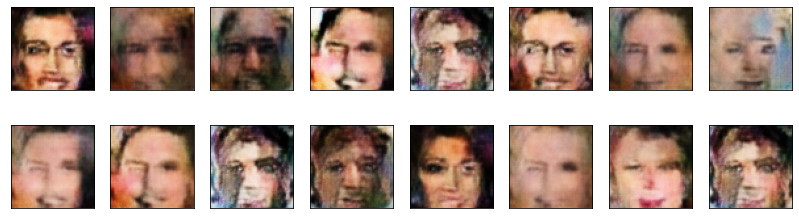

2023-11-02 18:51:58 | Epoch [32/60] | Batch 0/509 | d_loss: -94.8276 | g_loss: -2190.2480
2023-11-02 18:52:06 | Epoch [32/60] | Batch 50/509 | d_loss: -127.4250 | g_loss: -1791.9438
2023-11-02 18:52:14 | Epoch [32/60] | Batch 100/509 | d_loss: -167.0340 | g_loss: -1741.0273
2023-11-02 18:52:22 | Epoch [32/60] | Batch 150/509 | d_loss: -101.4319 | g_loss: -1209.3518
2023-11-02 18:52:31 | Epoch [32/60] | Batch 200/509 | d_loss: -84.6352 | g_loss: -1792.9442
2023-11-02 18:52:40 | Epoch [32/60] | Batch 250/509 | d_loss: -186.5221 | g_loss: -3206.1045
2023-11-02 18:52:48 | Epoch [32/60] | Batch 300/509 | d_loss: -139.8668 | g_loss: -1432.5118
2023-11-02 18:52:57 | Epoch [32/60] | Batch 350/509 | d_loss: -153.0971 | g_loss: -3068.8132
2023-11-02 18:53:06 | Epoch [32/60] | Batch 400/509 | d_loss: -103.9411 | g_loss: -2927.1492
2023-11-02 18:53:14 | Epoch [32/60] | Batch 450/509 | d_loss: -117.8054 | g_loss: -1279.1101
2023-11-02 18:53:23 | Epoch [32/60] | Batch 500/509 | d_loss: -113.1104 | g

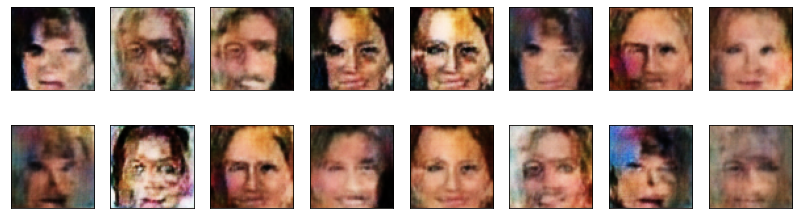

2023-11-02 18:53:29 | Epoch [33/60] | Batch 0/509 | d_loss: -125.4415 | g_loss: -2687.7202
2023-11-02 18:53:37 | Epoch [33/60] | Batch 50/509 | d_loss: -180.1880 | g_loss: -2117.9346
2023-11-02 18:53:45 | Epoch [33/60] | Batch 100/509 | d_loss: -93.1160 | g_loss: -2582.0508
2023-11-02 18:53:52 | Epoch [33/60] | Batch 150/509 | d_loss: -140.6732 | g_loss: -2319.1377
2023-11-02 18:54:01 | Epoch [33/60] | Batch 200/509 | d_loss: -142.3626 | g_loss: -2199.3843
2023-11-02 18:54:10 | Epoch [33/60] | Batch 250/509 | d_loss: -94.1271 | g_loss: -2746.6970
2023-11-02 18:54:19 | Epoch [33/60] | Batch 300/509 | d_loss: -83.5223 | g_loss: -3442.4854
2023-11-02 18:54:28 | Epoch [33/60] | Batch 350/509 | d_loss: -203.2750 | g_loss: -4207.1426
2023-11-02 18:54:37 | Epoch [33/60] | Batch 400/509 | d_loss: -148.1465 | g_loss: -2311.4202
2023-11-02 18:54:45 | Epoch [33/60] | Batch 450/509 | d_loss: -76.8500 | g_loss: -2849.9111
2023-11-02 18:54:54 | Epoch [33/60] | Batch 500/509 | d_loss: -87.8707 | g_lo

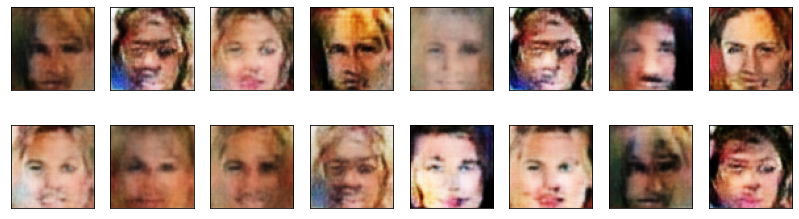

2023-11-02 18:55:01 | Epoch [34/60] | Batch 0/509 | d_loss: -110.1389 | g_loss: -2859.7866
2023-11-02 18:55:09 | Epoch [34/60] | Batch 50/509 | d_loss: -218.6532 | g_loss: -2844.1665
2023-11-02 18:55:17 | Epoch [34/60] | Batch 100/509 | d_loss: -145.9395 | g_loss: -1786.7532
2023-11-02 18:55:24 | Epoch [34/60] | Batch 150/509 | d_loss: -163.4156 | g_loss: -3766.0396
2023-11-02 18:55:33 | Epoch [34/60] | Batch 200/509 | d_loss: -88.1633 | g_loss: -1778.9276
2023-11-02 18:55:42 | Epoch [34/60] | Batch 250/509 | d_loss: -129.6340 | g_loss: -2146.8721
2023-11-02 18:55:51 | Epoch [34/60] | Batch 300/509 | d_loss: -132.2612 | g_loss: -1029.1228
2023-11-02 18:55:59 | Epoch [34/60] | Batch 350/509 | d_loss: -124.8390 | g_loss: -3987.4810
2023-11-02 18:56:08 | Epoch [34/60] | Batch 400/509 | d_loss: -107.2486 | g_loss: -2596.6689
2023-11-02 18:56:16 | Epoch [34/60] | Batch 450/509 | d_loss: -116.2515 | g_loss: -1541.3202
2023-11-02 18:56:25 | Epoch [34/60] | Batch 500/509 | d_loss: -135.8835 | 

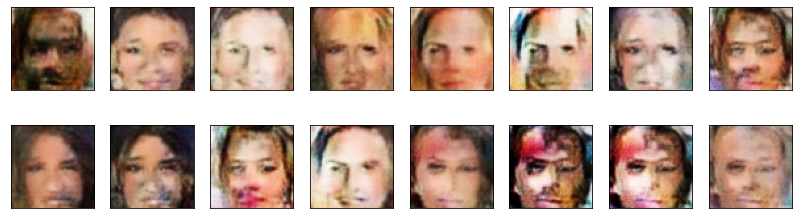

2023-11-02 18:56:31 | Epoch [35/60] | Batch 0/509 | d_loss: -64.2674 | g_loss: -1999.5306
2023-11-02 18:56:40 | Epoch [35/60] | Batch 50/509 | d_loss: -94.6275 | g_loss: -2546.9656
2023-11-02 18:56:47 | Epoch [35/60] | Batch 100/509 | d_loss: -112.5282 | g_loss: -2332.9395
2023-11-02 18:56:55 | Epoch [35/60] | Batch 150/509 | d_loss: -127.7067 | g_loss: -2407.6714
2023-11-02 18:57:04 | Epoch [35/60] | Batch 200/509 | d_loss: -226.9262 | g_loss: -3165.2666
2023-11-02 18:57:12 | Epoch [35/60] | Batch 250/509 | d_loss: -87.3783 | g_loss: -2890.4214
2023-11-02 18:57:21 | Epoch [35/60] | Batch 300/509 | d_loss: -87.2149 | g_loss: -2766.1147
2023-11-02 18:57:30 | Epoch [35/60] | Batch 350/509 | d_loss: -124.8149 | g_loss: -2058.8262
2023-11-02 18:57:39 | Epoch [35/60] | Batch 400/509 | d_loss: -151.7911 | g_loss: -2447.0859
2023-11-02 18:57:48 | Epoch [35/60] | Batch 450/509 | d_loss: -233.3643 | g_loss: -3481.0024
2023-11-02 18:57:56 | Epoch [35/60] | Batch 500/509 | d_loss: -106.3881 | g_l

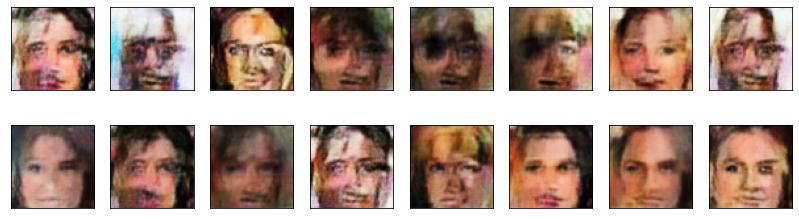

2023-11-02 18:58:01 | Epoch [36/60] | Batch 0/509 | d_loss: -133.3946 | g_loss: -2429.4587
2023-11-02 18:58:10 | Epoch [36/60] | Batch 50/509 | d_loss: -153.8840 | g_loss: -3683.9490
2023-11-02 18:58:18 | Epoch [36/60] | Batch 100/509 | d_loss: -146.3115 | g_loss: -3561.6096
2023-11-02 18:58:26 | Epoch [36/60] | Batch 150/509 | d_loss: -146.5822 | g_loss: -3676.0327
2023-11-02 18:58:34 | Epoch [36/60] | Batch 200/509 | d_loss: -130.5059 | g_loss: -3707.8479
2023-11-02 18:58:43 | Epoch [36/60] | Batch 250/509 | d_loss: -109.8157 | g_loss: -3407.1113
2023-11-02 18:58:52 | Epoch [36/60] | Batch 300/509 | d_loss: -102.9912 | g_loss: -3499.3091
2023-11-02 18:59:00 | Epoch [36/60] | Batch 350/509 | d_loss: -151.5835 | g_loss: -2741.6245
2023-11-02 18:59:09 | Epoch [36/60] | Batch 400/509 | d_loss: -111.8960 | g_loss: -2993.5891
2023-11-02 18:59:17 | Epoch [36/60] | Batch 450/509 | d_loss: -156.7048 | g_loss: -2412.2747
2023-11-02 18:59:26 | Epoch [36/60] | Batch 500/509 | d_loss: -131.4466 |

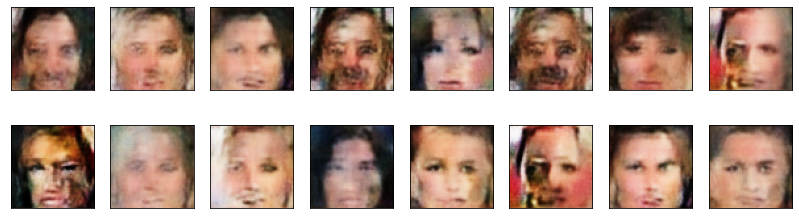

2023-11-02 18:59:32 | Epoch [37/60] | Batch 0/509 | d_loss: -131.4723 | g_loss: -3866.8716
2023-11-02 18:59:41 | Epoch [37/60] | Batch 50/509 | d_loss: -218.3337 | g_loss: -2999.6016
2023-11-02 18:59:49 | Epoch [37/60] | Batch 100/509 | d_loss: -124.4750 | g_loss: -3401.1382
2023-11-02 18:59:57 | Epoch [37/60] | Batch 150/509 | d_loss: -126.8345 | g_loss: -2680.1519
2023-11-02 19:00:05 | Epoch [37/60] | Batch 200/509 | d_loss: -147.2823 | g_loss: -3056.8845
2023-11-02 19:00:13 | Epoch [37/60] | Batch 250/509 | d_loss: -107.6688 | g_loss: -3135.9771
2023-11-02 19:00:22 | Epoch [37/60] | Batch 300/509 | d_loss: -132.2007 | g_loss: -3360.2112
2023-11-02 19:00:31 | Epoch [37/60] | Batch 350/509 | d_loss: -106.9712 | g_loss: -3460.0239
2023-11-02 19:00:39 | Epoch [37/60] | Batch 400/509 | d_loss: -138.4103 | g_loss: -2010.5012
2023-11-02 19:00:48 | Epoch [37/60] | Batch 450/509 | d_loss: -115.0128 | g_loss: -2591.1492
2023-11-02 19:00:57 | Epoch [37/60] | Batch 500/509 | d_loss: -104.6152 |

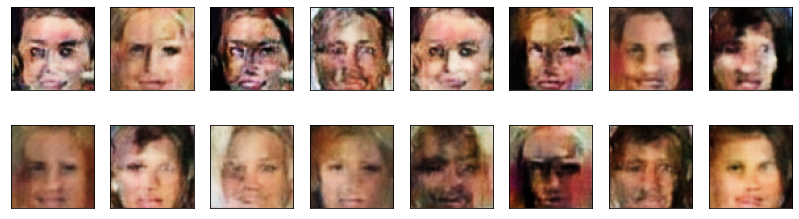

2023-11-02 19:01:03 | Epoch [38/60] | Batch 0/509 | d_loss: -129.0789 | g_loss: -2704.9800
2023-11-02 19:01:12 | Epoch [38/60] | Batch 50/509 | d_loss: -117.7596 | g_loss: -2829.0078
2023-11-02 19:01:20 | Epoch [38/60] | Batch 100/509 | d_loss: -116.5175 | g_loss: -3750.2046
2023-11-02 19:01:28 | Epoch [38/60] | Batch 150/509 | d_loss: -144.3909 | g_loss: -3142.2830
2023-11-02 19:01:36 | Epoch [38/60] | Batch 200/509 | d_loss: -142.8913 | g_loss: -2626.6355
2023-11-02 19:01:45 | Epoch [38/60] | Batch 250/509 | d_loss: -109.4439 | g_loss: -2969.6152
2023-11-02 19:01:54 | Epoch [38/60] | Batch 300/509 | d_loss: 2.6593 | g_loss: -4252.0034
2023-11-02 19:02:02 | Epoch [38/60] | Batch 350/509 | d_loss: -96.6624 | g_loss: -4317.8525
2023-11-02 19:02:11 | Epoch [38/60] | Batch 400/509 | d_loss: -141.4955 | g_loss: -2063.3435
2023-11-02 19:02:20 | Epoch [38/60] | Batch 450/509 | d_loss: -137.9507 | g_loss: -4691.7256
2023-11-02 19:02:28 | Epoch [38/60] | Batch 500/509 | d_loss: -121.4392 | g_l

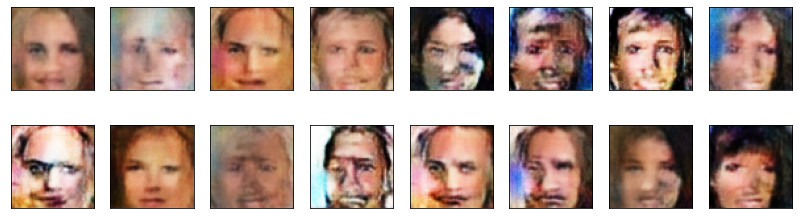

2023-11-02 19:02:35 | Epoch [39/60] | Batch 0/509 | d_loss: -101.8341 | g_loss: -3918.1396
2023-11-02 19:02:43 | Epoch [39/60] | Batch 50/509 | d_loss: -110.7821 | g_loss: -2441.2910
2023-11-02 19:02:52 | Epoch [39/60] | Batch 100/509 | d_loss: -114.2074 | g_loss: -3708.7920
2023-11-02 19:02:59 | Epoch [39/60] | Batch 150/509 | d_loss: -76.2758 | g_loss: -2792.6094
2023-11-02 19:03:07 | Epoch [39/60] | Batch 200/509 | d_loss: -113.4228 | g_loss: -3949.5042
2023-11-02 19:03:16 | Epoch [39/60] | Batch 250/509 | d_loss: -124.9648 | g_loss: -3083.3806
2023-11-02 19:03:25 | Epoch [39/60] | Batch 300/509 | d_loss: -110.4238 | g_loss: -3707.9019
2023-11-02 19:03:33 | Epoch [39/60] | Batch 350/509 | d_loss: -154.0105 | g_loss: -2596.9634
2023-11-02 19:03:42 | Epoch [39/60] | Batch 400/509 | d_loss: -161.0623 | g_loss: -2798.2087
2023-11-02 19:03:50 | Epoch [39/60] | Batch 450/509 | d_loss: -61.8194 | g_loss: -3267.3682
2023-11-02 19:03:59 | Epoch [39/60] | Batch 500/509 | d_loss: -129.0490 | g

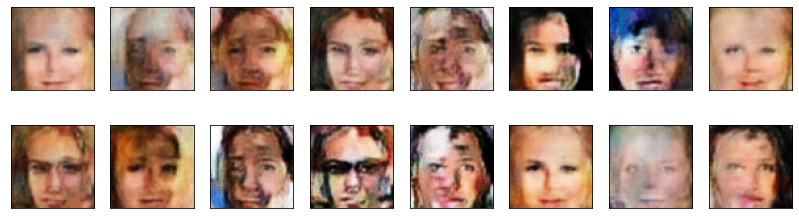

2023-11-02 19:04:05 | Epoch [40/60] | Batch 0/509 | d_loss: -82.3954 | g_loss: -3760.2295
2023-11-02 19:04:14 | Epoch [40/60] | Batch 50/509 | d_loss: -118.2200 | g_loss: -3524.6108
2023-11-02 19:04:23 | Epoch [40/60] | Batch 100/509 | d_loss: -96.2030 | g_loss: -3500.0813
2023-11-02 19:04:31 | Epoch [40/60] | Batch 150/509 | d_loss: -109.5339 | g_loss: -2999.8013
2023-11-02 19:04:38 | Epoch [40/60] | Batch 200/509 | d_loss: -81.2913 | g_loss: -3132.0298
2023-11-02 19:04:46 | Epoch [40/60] | Batch 250/509 | d_loss: -146.6515 | g_loss: -3469.4534
2023-11-02 19:04:54 | Epoch [40/60] | Batch 300/509 | d_loss: -138.5116 | g_loss: -2916.0259
2023-11-02 19:05:03 | Epoch [40/60] | Batch 350/509 | d_loss: -90.2945 | g_loss: -3390.2227
2023-11-02 19:05:12 | Epoch [40/60] | Batch 400/509 | d_loss: -134.7833 | g_loss: -2800.8511
2023-11-02 19:05:21 | Epoch [40/60] | Batch 450/509 | d_loss: -48.7030 | g_loss: -2840.3701
2023-11-02 19:05:29 | Epoch [40/60] | Batch 500/509 | d_loss: -112.4746 | g_lo

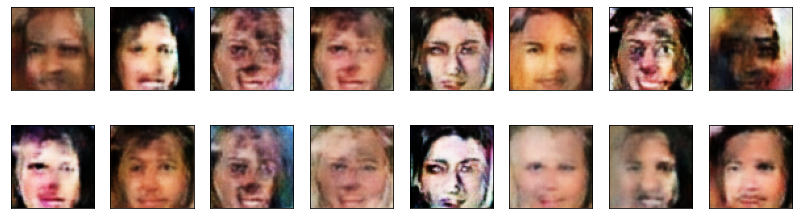

2023-11-02 19:05:35 | Epoch [41/60] | Batch 0/509 | d_loss: -54.5014 | g_loss: -4363.0728
2023-11-02 19:05:43 | Epoch [41/60] | Batch 50/509 | d_loss: -125.4231 | g_loss: -3413.9316
2023-11-02 19:05:52 | Epoch [41/60] | Batch 100/509 | d_loss: -93.8715 | g_loss: -2942.0547
2023-11-02 19:06:01 | Epoch [41/60] | Batch 150/509 | d_loss: -133.4522 | g_loss: -2797.5168
2023-11-02 19:06:09 | Epoch [41/60] | Batch 200/509 | d_loss: -93.6698 | g_loss: -4034.3579
2023-11-02 19:06:17 | Epoch [41/60] | Batch 250/509 | d_loss: -182.0065 | g_loss: -4554.1860
2023-11-02 19:06:25 | Epoch [41/60] | Batch 300/509 | d_loss: -112.3076 | g_loss: -2246.0283
2023-11-02 19:06:33 | Epoch [41/60] | Batch 350/509 | d_loss: -12.7423 | g_loss: -2785.2593
2023-11-02 19:06:42 | Epoch [41/60] | Batch 400/509 | d_loss: -65.3092 | g_loss: -3276.2454
2023-11-02 19:06:51 | Epoch [41/60] | Batch 450/509 | d_loss: -75.4309 | g_loss: -3293.5437
2023-11-02 19:06:59 | Epoch [41/60] | Batch 500/509 | d_loss: -76.8059 | g_loss

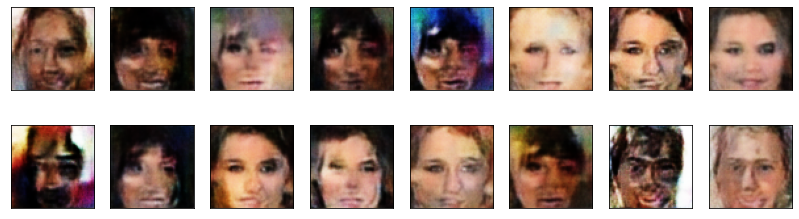

2023-11-02 19:07:06 | Epoch [42/60] | Batch 0/509 | d_loss: -171.9148 | g_loss: -2174.2485
2023-11-02 19:07:15 | Epoch [42/60] | Batch 50/509 | d_loss: -176.4801 | g_loss: -4016.6567
2023-11-02 19:07:23 | Epoch [42/60] | Batch 100/509 | d_loss: -140.1577 | g_loss: -2538.9636
2023-11-02 19:07:32 | Epoch [42/60] | Batch 150/509 | d_loss: -86.8451 | g_loss: -3683.4072
2023-11-02 19:07:40 | Epoch [42/60] | Batch 200/509 | d_loss: -119.2325 | g_loss: -4690.0840
2023-11-02 19:07:48 | Epoch [42/60] | Batch 250/509 | d_loss: -20.5935 | g_loss: -3954.0300
2023-11-02 19:07:56 | Epoch [42/60] | Batch 300/509 | d_loss: -111.2167 | g_loss: -2582.2681
2023-11-02 19:08:05 | Epoch [42/60] | Batch 350/509 | d_loss: -99.6334 | g_loss: -3629.7100
2023-11-02 19:08:13 | Epoch [42/60] | Batch 400/509 | d_loss: -55.2201 | g_loss: -3993.5728
2023-11-02 19:08:22 | Epoch [42/60] | Batch 450/509 | d_loss: -73.0760 | g_loss: -2785.9858
2023-11-02 19:08:31 | Epoch [42/60] | Batch 500/509 | d_loss: -121.0927 | g_lo

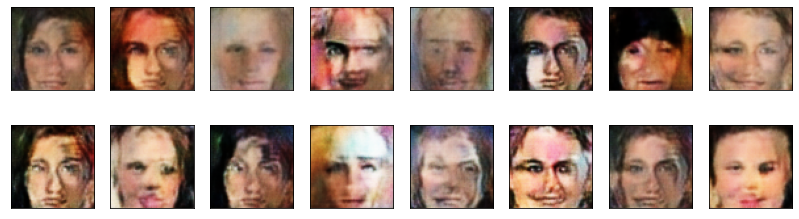

2023-11-02 19:08:36 | Epoch [43/60] | Batch 0/509 | d_loss: -77.1212 | g_loss: -3018.3938
2023-11-02 19:08:45 | Epoch [43/60] | Batch 50/509 | d_loss: -102.1741 | g_loss: -2833.2710
2023-11-02 19:08:54 | Epoch [43/60] | Batch 100/509 | d_loss: -72.1144 | g_loss: -3785.5061
2023-11-02 19:09:02 | Epoch [43/60] | Batch 150/509 | d_loss: -101.2873 | g_loss: -2727.6846
2023-11-02 19:09:10 | Epoch [43/60] | Batch 200/509 | d_loss: -117.7345 | g_loss: -3485.6260
2023-11-02 19:09:18 | Epoch [43/60] | Batch 250/509 | d_loss: -127.4384 | g_loss: -3040.2014
2023-11-02 19:09:26 | Epoch [43/60] | Batch 300/509 | d_loss: -118.8428 | g_loss: -2588.8164
2023-11-02 19:09:35 | Epoch [43/60] | Batch 350/509 | d_loss: -104.1183 | g_loss: -4431.6152
2023-11-02 19:09:44 | Epoch [43/60] | Batch 400/509 | d_loss: -90.3796 | g_loss: -2860.8228
2023-11-02 19:09:53 | Epoch [43/60] | Batch 450/509 | d_loss: -117.6640 | g_loss: -3245.0598
2023-11-02 19:10:01 | Epoch [43/60] | Batch 500/509 | d_loss: -155.2694 | g_

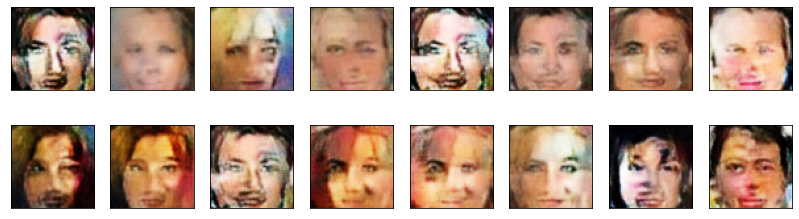

2023-11-02 19:10:08 | Epoch [44/60] | Batch 0/509 | d_loss: -117.2940 | g_loss: -3583.8901
2023-11-02 19:10:17 | Epoch [44/60] | Batch 50/509 | d_loss: -140.6450 | g_loss: -3019.3506
2023-11-02 19:10:25 | Epoch [44/60] | Batch 100/509 | d_loss: -95.9233 | g_loss: -2941.9221
2023-11-02 19:10:34 | Epoch [44/60] | Batch 150/509 | d_loss: -110.9973 | g_loss: -2792.7019
2023-11-02 19:10:42 | Epoch [44/60] | Batch 200/509 | d_loss: -87.1521 | g_loss: -3611.3872
2023-11-02 19:10:50 | Epoch [44/60] | Batch 250/509 | d_loss: -93.0136 | g_loss: -4091.7456
2023-11-02 19:10:58 | Epoch [44/60] | Batch 300/509 | d_loss: -106.0741 | g_loss: -3985.7495
2023-11-02 19:11:06 | Epoch [44/60] | Batch 350/509 | d_loss: -112.1290 | g_loss: -3625.0762
2023-11-02 19:11:15 | Epoch [44/60] | Batch 400/509 | d_loss: -136.0586 | g_loss: -3517.2153
2023-11-02 19:11:24 | Epoch [44/60] | Batch 450/509 | d_loss: -129.1307 | g_loss: -3578.1604
2023-11-02 19:11:32 | Epoch [44/60] | Batch 500/509 | d_loss: -117.9506 | g_

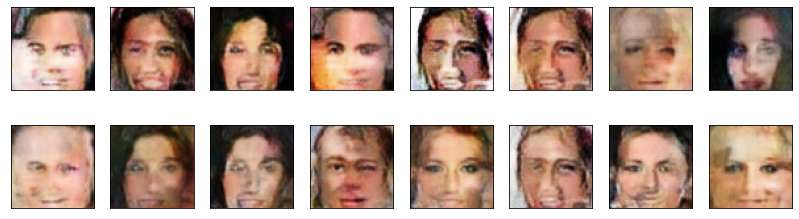

2023-11-02 19:11:38 | Epoch [45/60] | Batch 0/509 | d_loss: -129.9699 | g_loss: -4905.6055
2023-11-02 19:11:47 | Epoch [45/60] | Batch 50/509 | d_loss: -106.3111 | g_loss: -4339.8540
2023-11-02 19:11:56 | Epoch [45/60] | Batch 100/509 | d_loss: -92.7639 | g_loss: -3357.3984
2023-11-02 19:12:04 | Epoch [45/60] | Batch 150/509 | d_loss: -123.3246 | g_loss: -3879.9609
2023-11-02 19:12:13 | Epoch [45/60] | Batch 200/509 | d_loss: -149.4907 | g_loss: -3178.4136
2023-11-02 19:12:21 | Epoch [45/60] | Batch 250/509 | d_loss: -149.8799 | g_loss: -3124.2305
2023-11-02 19:12:29 | Epoch [45/60] | Batch 300/509 | d_loss: -85.8182 | g_loss: -3454.8555
2023-11-02 19:12:37 | Epoch [45/60] | Batch 350/509 | d_loss: -64.0614 | g_loss: -3778.2402
2023-11-02 19:12:46 | Epoch [45/60] | Batch 400/509 | d_loss: -84.9001 | g_loss: -3640.1226
2023-11-02 19:12:54 | Epoch [45/60] | Batch 450/509 | d_loss: -136.3588 | g_loss: -3465.2893
2023-11-02 19:13:03 | Epoch [45/60] | Batch 500/509 | d_loss: -72.6095 | g_lo

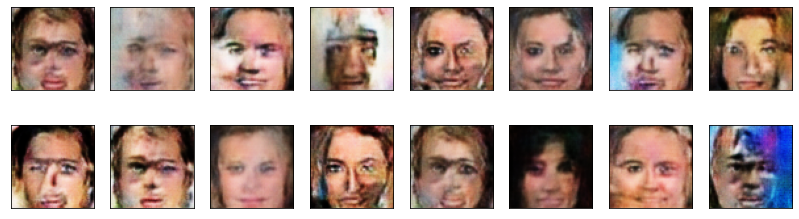

2023-11-02 19:13:08 | Epoch [46/60] | Batch 0/509 | d_loss: -131.4616 | g_loss: -2633.2112
2023-11-02 19:13:17 | Epoch [46/60] | Batch 50/509 | d_loss: -87.9805 | g_loss: -3493.9089
2023-11-02 19:13:25 | Epoch [46/60] | Batch 100/509 | d_loss: -91.2305 | g_loss: -2914.7520
2023-11-02 19:13:34 | Epoch [46/60] | Batch 150/509 | d_loss: -87.8810 | g_loss: -2579.2891
2023-11-02 19:13:43 | Epoch [46/60] | Batch 200/509 | d_loss: -131.5321 | g_loss: -2889.2622
2023-11-02 19:13:51 | Epoch [46/60] | Batch 250/509 | d_loss: -78.8785 | g_loss: -4287.4463
2023-11-02 19:13:59 | Epoch [46/60] | Batch 300/509 | d_loss: -113.1505 | g_loss: -3089.1311
2023-11-02 19:14:07 | Epoch [46/60] | Batch 350/509 | d_loss: -143.8087 | g_loss: -3956.0435
2023-11-02 19:14:16 | Epoch [46/60] | Batch 400/509 | d_loss: -143.9932 | g_loss: -3373.3926
2023-11-02 19:14:25 | Epoch [46/60] | Batch 450/509 | d_loss: -111.6650 | g_loss: -3468.3892
2023-11-02 19:14:33 | Epoch [46/60] | Batch 500/509 | d_loss: -64.3554 | g_lo

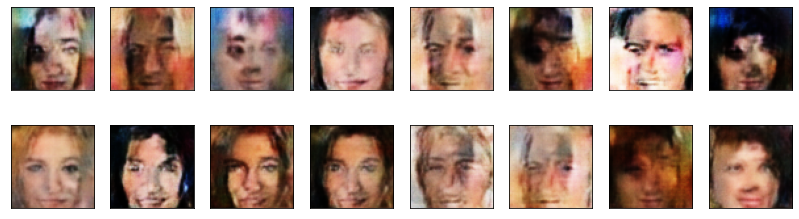

2023-11-02 19:14:39 | Epoch [47/60] | Batch 0/509 | d_loss: -133.8824 | g_loss: -3550.1665
2023-11-02 19:14:47 | Epoch [47/60] | Batch 50/509 | d_loss: -119.3102 | g_loss: -3375.2473
2023-11-02 19:14:56 | Epoch [47/60] | Batch 100/509 | d_loss: -169.3956 | g_loss: -3385.9614
2023-11-02 19:15:04 | Epoch [47/60] | Batch 150/509 | d_loss: -51.0129 | g_loss: -3594.5840
2023-11-02 19:15:13 | Epoch [47/60] | Batch 200/509 | d_loss: -155.6503 | g_loss: -2678.9116
2023-11-02 19:15:22 | Epoch [47/60] | Batch 250/509 | d_loss: -92.1318 | g_loss: -3645.2397
2023-11-02 19:15:30 | Epoch [47/60] | Batch 300/509 | d_loss: -68.6614 | g_loss: -3333.6003
2023-11-02 19:15:38 | Epoch [47/60] | Batch 350/509 | d_loss: -117.5339 | g_loss: -3197.7576
2023-11-02 19:15:54 | Epoch [47/60] | Batch 450/509 | d_loss: -158.7091 | g_loss: -2962.0840
2023-11-02 19:16:03 | Epoch [47/60] | Batch 500/509 | d_loss: -99.7227 | g_loss: -3671.3630


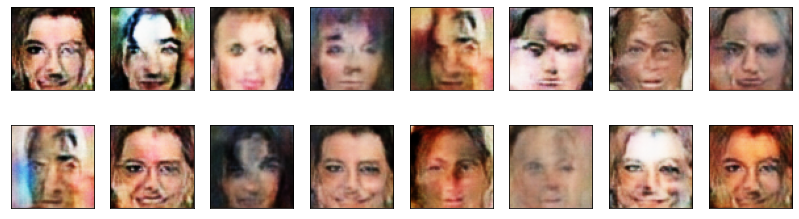

2023-11-02 19:16:10 | Epoch [48/60] | Batch 0/509 | d_loss: -79.6761 | g_loss: -3048.6851
2023-11-02 19:16:19 | Epoch [48/60] | Batch 50/509 | d_loss: -88.3059 | g_loss: -4099.6777
2023-11-02 19:16:28 | Epoch [48/60] | Batch 100/509 | d_loss: -86.7721 | g_loss: -3737.2456
2023-11-02 19:16:36 | Epoch [48/60] | Batch 150/509 | d_loss: -99.6166 | g_loss: -4030.1294
2023-11-02 19:16:45 | Epoch [48/60] | Batch 200/509 | d_loss: -131.1430 | g_loss: -3218.7927
2023-11-02 19:16:54 | Epoch [48/60] | Batch 250/509 | d_loss: -121.5667 | g_loss: -2557.6626
2023-11-02 19:17:02 | Epoch [48/60] | Batch 300/509 | d_loss: -128.0958 | g_loss: -3297.5979
2023-11-02 19:17:09 | Epoch [48/60] | Batch 350/509 | d_loss: -115.8350 | g_loss: -3902.7803
2023-11-02 19:17:17 | Epoch [48/60] | Batch 400/509 | d_loss: -86.5520 | g_loss: -3990.6489
2023-11-02 19:17:26 | Epoch [48/60] | Batch 450/509 | d_loss: -149.5712 | g_loss: -3763.5500
2023-11-02 19:17:35 | Epoch [48/60] | Batch 500/509 | d_loss: -122.4051 | g_lo

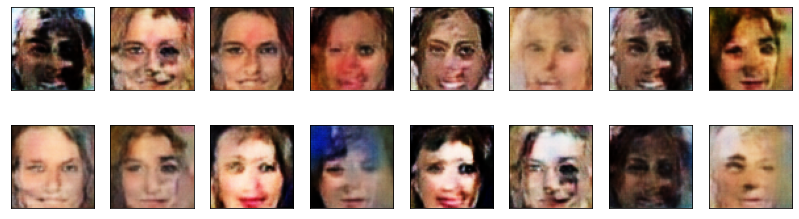

2023-11-02 19:17:40 | Epoch [49/60] | Batch 0/509 | d_loss: -103.9464 | g_loss: -4769.9497
2023-11-02 19:17:49 | Epoch [49/60] | Batch 50/509 | d_loss: -111.5449 | g_loss: -2809.2019
2023-11-02 19:17:57 | Epoch [49/60] | Batch 100/509 | d_loss: -146.7754 | g_loss: -3885.4307
2023-11-02 19:18:06 | Epoch [49/60] | Batch 150/509 | d_loss: -79.7770 | g_loss: -4078.5776
2023-11-02 19:18:15 | Epoch [49/60] | Batch 200/509 | d_loss: -133.5731 | g_loss: -3626.0459
2023-11-02 19:18:24 | Epoch [49/60] | Batch 250/509 | d_loss: -89.2588 | g_loss: -3904.0076
2023-11-02 19:18:32 | Epoch [49/60] | Batch 300/509 | d_loss: -135.0852 | g_loss: -4096.1060
2023-11-02 19:18:40 | Epoch [49/60] | Batch 350/509 | d_loss: -73.2442 | g_loss: -3933.7043
2023-11-02 19:18:48 | Epoch [49/60] | Batch 400/509 | d_loss: -101.2749 | g_loss: -4245.3662
2023-11-02 19:18:56 | Epoch [49/60] | Batch 450/509 | d_loss: -95.7071 | g_loss: -2812.2026
2023-11-02 19:19:05 | Epoch [49/60] | Batch 500/509 | d_loss: -151.4117 | g_l

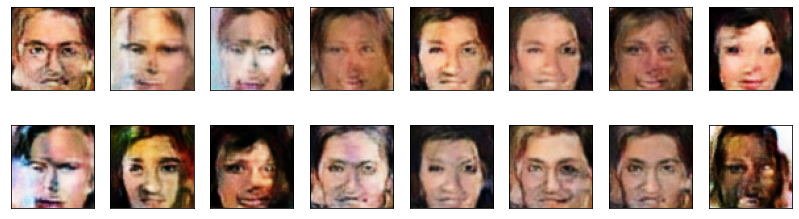

2023-11-02 19:19:10 | Epoch [50/60] | Batch 0/509 | d_loss: -117.6863 | g_loss: -4266.5469
2023-11-02 19:19:19 | Epoch [50/60] | Batch 50/509 | d_loss: -119.9937 | g_loss: -4265.9512
2023-11-02 19:19:27 | Epoch [50/60] | Batch 100/509 | d_loss: -123.6741 | g_loss: -4386.8418
2023-11-02 19:19:36 | Epoch [50/60] | Batch 150/509 | d_loss: -134.0148 | g_loss: -4446.8955
2023-11-02 19:19:45 | Epoch [50/60] | Batch 200/509 | d_loss: -96.4005 | g_loss: -4360.4072
2023-11-02 19:19:54 | Epoch [50/60] | Batch 250/509 | d_loss: -106.4361 | g_loss: -3509.8662
2023-11-02 19:20:01 | Epoch [50/60] | Batch 300/509 | d_loss: -88.8505 | g_loss: -3861.8391
2023-11-02 19:20:09 | Epoch [50/60] | Batch 350/509 | d_loss: -110.0555 | g_loss: -3670.1316
2023-11-02 19:20:16 | Epoch [50/60] | Batch 400/509 | d_loss: -90.4993 | g_loss: -4028.7708
2023-11-02 19:20:24 | Epoch [50/60] | Batch 450/509 | d_loss: -104.6557 | g_loss: -4283.7422
2023-11-02 19:20:32 | Epoch [50/60] | Batch 500/509 | d_loss: -139.2988 | g_

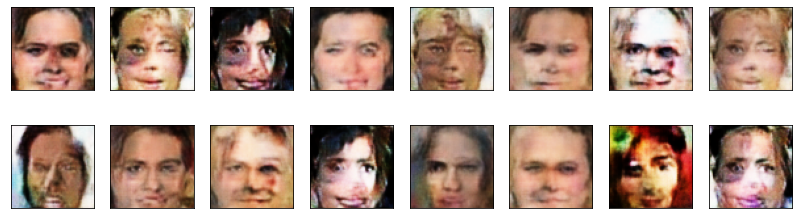

2023-11-02 19:20:38 | Epoch [51/60] | Batch 0/509 | d_loss: -131.8846 | g_loss: -3734.5796
2023-11-02 19:20:45 | Epoch [51/60] | Batch 50/509 | d_loss: -60.4171 | g_loss: -4195.9277
2023-11-02 19:20:53 | Epoch [51/60] | Batch 100/509 | d_loss: -87.4661 | g_loss: -4394.0811
2023-11-02 19:21:00 | Epoch [51/60] | Batch 150/509 | d_loss: -138.2292 | g_loss: -2510.7585
2023-11-02 19:21:08 | Epoch [51/60] | Batch 200/509 | d_loss: -152.2312 | g_loss: -3709.5881
2023-11-02 19:21:15 | Epoch [51/60] | Batch 250/509 | d_loss: -146.3330 | g_loss: -3404.8726
2023-11-02 19:21:23 | Epoch [51/60] | Batch 300/509 | d_loss: -134.7159 | g_loss: -3412.7444
2023-11-02 19:21:30 | Epoch [51/60] | Batch 350/509 | d_loss: -73.8143 | g_loss: -3814.1536
2023-11-02 19:21:38 | Epoch [51/60] | Batch 400/509 | d_loss: -101.9994 | g_loss: -3557.8989
2023-11-02 19:21:45 | Epoch [51/60] | Batch 450/509 | d_loss: -119.6814 | g_loss: -3361.3433
2023-11-02 19:21:53 | Epoch [51/60] | Batch 500/509 | d_loss: -160.3033 | g_

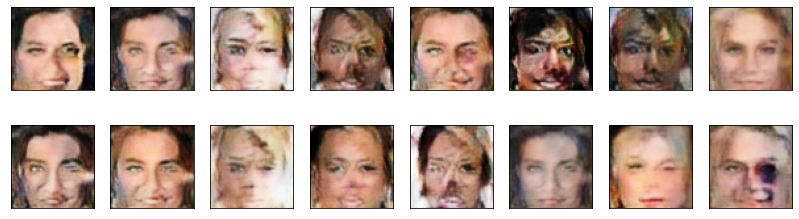

2023-11-02 19:21:59 | Epoch [52/60] | Batch 0/509 | d_loss: -100.6952 | g_loss: -3781.3081
2023-11-02 19:22:06 | Epoch [52/60] | Batch 50/509 | d_loss: -114.0444 | g_loss: -3555.9482
2023-11-02 19:22:14 | Epoch [52/60] | Batch 100/509 | d_loss: -98.3513 | g_loss: -3989.0303
2023-11-02 19:22:21 | Epoch [52/60] | Batch 150/509 | d_loss: -113.9547 | g_loss: -3902.4536
2023-11-02 19:22:29 | Epoch [52/60] | Batch 200/509 | d_loss: -84.5060 | g_loss: -3628.0122
2023-11-02 19:22:36 | Epoch [52/60] | Batch 250/509 | d_loss: -71.5966 | g_loss: -4327.2827
2023-11-02 19:22:44 | Epoch [52/60] | Batch 300/509 | d_loss: -141.7010 | g_loss: -3409.6245
2023-11-02 19:22:52 | Epoch [52/60] | Batch 350/509 | d_loss: -133.7077 | g_loss: -3591.2063
2023-11-02 19:22:59 | Epoch [52/60] | Batch 400/509 | d_loss: -104.0955 | g_loss: -3731.4824
2023-11-02 19:23:07 | Epoch [52/60] | Batch 450/509 | d_loss: -77.3100 | g_loss: -3728.6301
2023-11-02 19:23:14 | Epoch [52/60] | Batch 500/509 | d_loss: -162.8456 | g_l

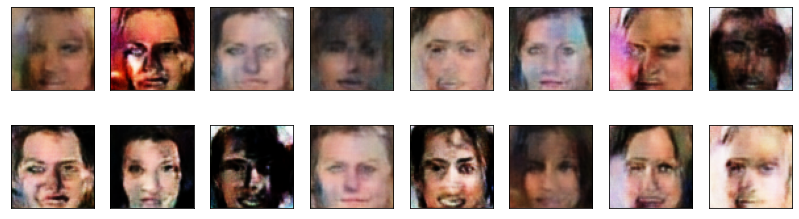

2023-11-02 19:23:20 | Epoch [53/60] | Batch 0/509 | d_loss: -105.1963 | g_loss: -4352.1128
2023-11-02 19:23:27 | Epoch [53/60] | Batch 50/509 | d_loss: -93.3425 | g_loss: -3806.1309
2023-11-02 19:23:35 | Epoch [53/60] | Batch 100/509 | d_loss: -120.2040 | g_loss: -3793.4060
2023-11-02 19:23:42 | Epoch [53/60] | Batch 150/509 | d_loss: -86.3787 | g_loss: -4109.8369
2023-11-02 19:23:50 | Epoch [53/60] | Batch 200/509 | d_loss: -94.0652 | g_loss: -3687.0532
2023-11-02 19:23:57 | Epoch [53/60] | Batch 250/509 | d_loss: -75.2500 | g_loss: -3041.7917
2023-11-02 19:24:05 | Epoch [53/60] | Batch 300/509 | d_loss: -108.4447 | g_loss: -3478.6382
2023-11-02 19:24:12 | Epoch [53/60] | Batch 350/509 | d_loss: -117.2160 | g_loss: -3715.9995
2023-11-02 19:24:20 | Epoch [53/60] | Batch 400/509 | d_loss: -99.7453 | g_loss: -3636.1748
2023-11-02 19:24:27 | Epoch [53/60] | Batch 450/509 | d_loss: -116.1867 | g_loss: -3929.3721
2023-11-02 19:24:35 | Epoch [53/60] | Batch 500/509 | d_loss: -66.6606 | g_los

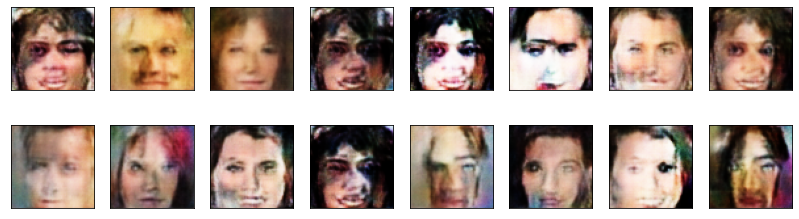

2023-11-02 19:24:41 | Epoch [54/60] | Batch 0/509 | d_loss: -120.1945 | g_loss: -2900.5352
2023-11-02 19:24:49 | Epoch [54/60] | Batch 50/509 | d_loss: -153.9215 | g_loss: -4403.3965
2023-11-02 19:24:56 | Epoch [54/60] | Batch 100/509 | d_loss: -103.8335 | g_loss: -3877.5952
2023-11-02 19:25:04 | Epoch [54/60] | Batch 150/509 | d_loss: -136.8194 | g_loss: -3632.0073
2023-11-02 19:25:11 | Epoch [54/60] | Batch 200/509 | d_loss: -104.3161 | g_loss: -4412.3853
2023-11-02 19:25:19 | Epoch [54/60] | Batch 250/509 | d_loss: -145.5423 | g_loss: -3431.4558
2023-11-02 19:25:26 | Epoch [54/60] | Batch 300/509 | d_loss: -103.7268 | g_loss: -3183.7349
2023-11-02 19:25:34 | Epoch [54/60] | Batch 350/509 | d_loss: -126.3872 | g_loss: -3563.9873
2023-11-02 19:25:41 | Epoch [54/60] | Batch 400/509 | d_loss: -117.3020 | g_loss: -3942.9214
2023-11-02 19:25:49 | Epoch [54/60] | Batch 450/509 | d_loss: -115.9722 | g_loss: -3541.4175
2023-11-02 19:25:56 | Epoch [54/60] | Batch 500/509 | d_loss: -74.1496 | 

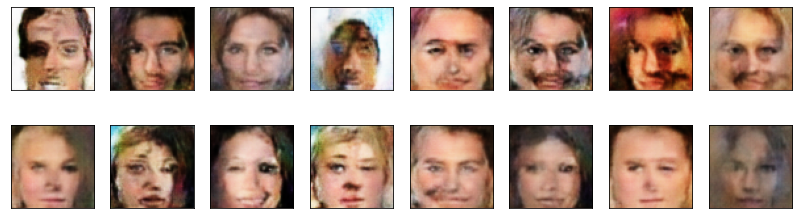

2023-11-02 19:26:02 | Epoch [55/60] | Batch 0/509 | d_loss: -45.4771 | g_loss: -3222.0115
2023-11-02 19:26:09 | Epoch [55/60] | Batch 50/509 | d_loss: -73.7979 | g_loss: -3511.4580
2023-11-02 19:26:17 | Epoch [55/60] | Batch 100/509 | d_loss: -89.8423 | g_loss: -3639.6411
2023-11-02 19:26:24 | Epoch [55/60] | Batch 150/509 | d_loss: -119.4382 | g_loss: -3297.5283
2023-11-02 19:26:32 | Epoch [55/60] | Batch 200/509 | d_loss: -47.0080 | g_loss: -3778.5571
2023-11-02 19:26:39 | Epoch [55/60] | Batch 250/509 | d_loss: -123.1037 | g_loss: -3251.0483
2023-11-02 19:26:47 | Epoch [55/60] | Batch 300/509 | d_loss: -97.4919 | g_loss: -4002.5676
2023-11-02 19:26:54 | Epoch [55/60] | Batch 350/509 | d_loss: -123.2222 | g_loss: -3402.0903
2023-11-02 19:27:02 | Epoch [55/60] | Batch 400/509 | d_loss: -90.7118 | g_loss: -4237.7505
2023-11-02 19:27:10 | Epoch [55/60] | Batch 450/509 | d_loss: -104.9266 | g_loss: -3771.3311
2023-11-02 19:27:17 | Epoch [55/60] | Batch 500/509 | d_loss: -53.4199 | g_loss

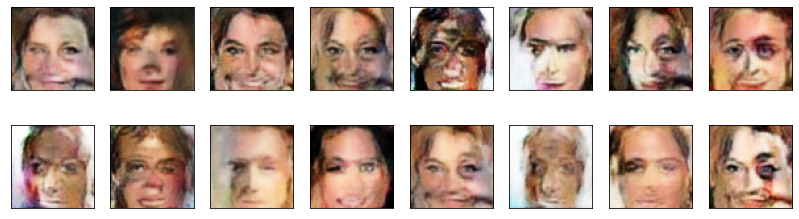

2023-11-02 19:27:23 | Epoch [56/60] | Batch 0/509 | d_loss: -12.0526 | g_loss: -3634.1538
2023-11-02 19:27:31 | Epoch [56/60] | Batch 50/509 | d_loss: -103.9388 | g_loss: -3324.9055
2023-11-02 19:27:38 | Epoch [56/60] | Batch 100/509 | d_loss: -61.0251 | g_loss: -4465.9795
2023-11-02 19:27:46 | Epoch [56/60] | Batch 150/509 | d_loss: -90.0867 | g_loss: -4432.1191
2023-11-02 19:27:53 | Epoch [56/60] | Batch 200/509 | d_loss: -56.7464 | g_loss: -4378.3496
2023-11-02 19:28:01 | Epoch [56/60] | Batch 250/509 | d_loss: -103.4052 | g_loss: -3914.8496
2023-11-02 19:28:08 | Epoch [56/60] | Batch 300/509 | d_loss: -67.9137 | g_loss: -3779.7505
2023-11-02 19:28:16 | Epoch [56/60] | Batch 350/509 | d_loss: -105.1358 | g_loss: -3962.1604
2023-11-02 19:28:23 | Epoch [56/60] | Batch 400/509 | d_loss: -61.0783 | g_loss: -3059.8872
2023-11-02 19:28:31 | Epoch [56/60] | Batch 450/509 | d_loss: -105.0214 | g_loss: -4175.5483
2023-11-02 19:28:38 | Epoch [56/60] | Batch 500/509 | d_loss: -73.6959 | g_loss

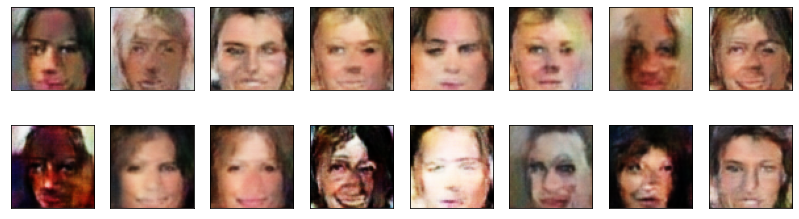

2023-11-02 19:28:43 | Epoch [57/60] | Batch 0/509 | d_loss: -109.5292 | g_loss: -3976.8562
2023-11-02 19:28:51 | Epoch [57/60] | Batch 50/509 | d_loss: -134.2045 | g_loss: -4598.8613
2023-11-02 19:28:59 | Epoch [57/60] | Batch 100/509 | d_loss: -123.2794 | g_loss: -2911.9380
2023-11-02 19:29:06 | Epoch [57/60] | Batch 150/509 | d_loss: -110.3929 | g_loss: -3332.0200
2023-11-02 19:29:14 | Epoch [57/60] | Batch 200/509 | d_loss: -110.0992 | g_loss: -3568.0264
2023-11-02 19:29:21 | Epoch [57/60] | Batch 250/509 | d_loss: -111.0418 | g_loss: -4473.7783
2023-11-02 19:29:29 | Epoch [57/60] | Batch 300/509 | d_loss: -111.1808 | g_loss: -4545.5073
2023-11-02 19:29:36 | Epoch [57/60] | Batch 350/509 | d_loss: -53.3192 | g_loss: -3579.5537
2023-11-02 19:29:44 | Epoch [57/60] | Batch 400/509 | d_loss: -120.3925 | g_loss: -4259.8130
2023-11-02 19:29:52 | Epoch [57/60] | Batch 450/509 | d_loss: -190.8382 | g_loss: -4264.9277
2023-11-02 19:29:59 | Epoch [57/60] | Batch 500/509 | d_loss: -116.6427 | 

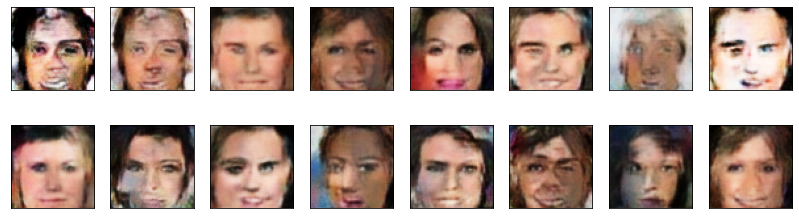

2023-11-02 19:30:05 | Epoch [58/60] | Batch 0/509 | d_loss: -84.2206 | g_loss: -3607.1406
2023-11-02 19:30:13 | Epoch [58/60] | Batch 50/509 | d_loss: -80.7101 | g_loss: -3762.8447
2023-11-02 19:30:20 | Epoch [58/60] | Batch 100/509 | d_loss: -127.9497 | g_loss: -4352.4585
2023-11-02 19:30:28 | Epoch [58/60] | Batch 150/509 | d_loss: -63.0577 | g_loss: -3844.3765
2023-11-02 19:30:35 | Epoch [58/60] | Batch 200/509 | d_loss: -102.4780 | g_loss: -3079.9888
2023-11-02 19:30:43 | Epoch [58/60] | Batch 250/509 | d_loss: -125.4330 | g_loss: -3272.7454
2023-11-02 19:30:50 | Epoch [58/60] | Batch 300/509 | d_loss: -208.2733 | g_loss: -4508.4521
2023-11-02 19:30:58 | Epoch [58/60] | Batch 350/509 | d_loss: -89.5683 | g_loss: -4222.7930
2023-11-02 19:31:05 | Epoch [58/60] | Batch 400/509 | d_loss: -124.4886 | g_loss: -3674.7822
2023-11-02 19:31:13 | Epoch [58/60] | Batch 450/509 | d_loss: -121.2748 | g_loss: -4296.2227
2023-11-02 19:31:21 | Epoch [58/60] | Batch 500/509 | d_loss: -108.1869 | g_l

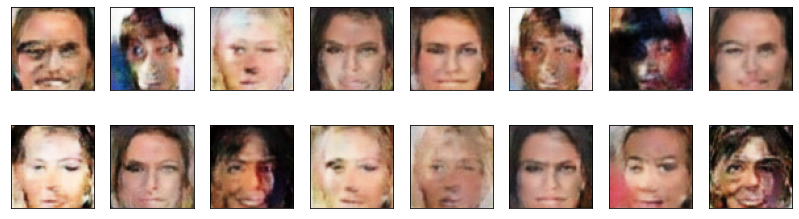

2023-11-02 19:31:26 | Epoch [59/60] | Batch 0/509 | d_loss: -107.4416 | g_loss: -3139.0063
2023-11-02 19:31:33 | Epoch [59/60] | Batch 50/509 | d_loss: -90.4623 | g_loss: -3510.9224
2023-11-02 19:31:41 | Epoch [59/60] | Batch 100/509 | d_loss: -137.8526 | g_loss: -3298.0117
2023-11-02 19:31:48 | Epoch [59/60] | Batch 150/509 | d_loss: -108.9499 | g_loss: -3596.9048
2023-11-02 19:31:56 | Epoch [59/60] | Batch 200/509 | d_loss: -131.5149 | g_loss: -3954.6731
2023-11-02 19:32:03 | Epoch [59/60] | Batch 250/509 | d_loss: -92.0526 | g_loss: -4184.0288
2023-11-02 19:32:11 | Epoch [59/60] | Batch 300/509 | d_loss: -102.7780 | g_loss: -3379.3477
2023-11-02 19:32:18 | Epoch [59/60] | Batch 350/509 | d_loss: -87.3034 | g_loss: -3957.1687
2023-11-02 19:32:26 | Epoch [59/60] | Batch 400/509 | d_loss: -87.6659 | g_loss: -3608.8726
2023-11-02 19:32:33 | Epoch [59/60] | Batch 450/509 | d_loss: -88.9238 | g_loss: -5057.9189
2023-11-02 19:32:41 | Epoch [59/60] | Batch 500/509 | d_loss: -120.9630 | g_lo

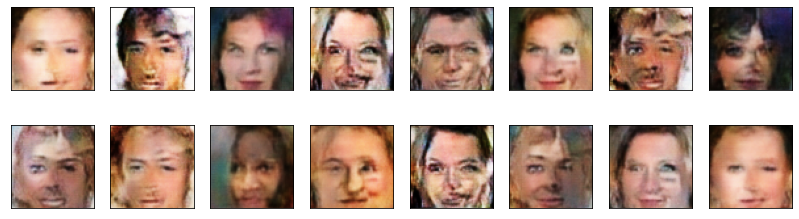

2023-11-02 19:32:47 | Epoch [60/60] | Batch 0/509 | d_loss: -95.5305 | g_loss: -3742.2134
2023-11-02 19:32:54 | Epoch [60/60] | Batch 50/509 | d_loss: -109.1231 | g_loss: -3592.3889
2023-11-02 19:33:02 | Epoch [60/60] | Batch 100/509 | d_loss: -104.6511 | g_loss: -3563.3828
2023-11-02 19:33:09 | Epoch [60/60] | Batch 150/509 | d_loss: -131.3785 | g_loss: -3792.3098
2023-11-02 19:33:17 | Epoch [60/60] | Batch 200/509 | d_loss: -162.7734 | g_loss: -4266.4492
2023-11-02 19:33:24 | Epoch [60/60] | Batch 250/509 | d_loss: -127.5605 | g_loss: -4414.4575
2023-11-02 19:33:32 | Epoch [60/60] | Batch 300/509 | d_loss: -120.6943 | g_loss: -4478.0010
2023-11-02 19:33:40 | Epoch [60/60] | Batch 350/509 | d_loss: -97.0986 | g_loss: -4656.2769
2023-11-02 19:33:47 | Epoch [60/60] | Batch 400/509 | d_loss: -44.1601 | g_loss: -3742.5000
2023-11-02 19:33:55 | Epoch [60/60] | Batch 450/509 | d_loss: -121.2135 | g_loss: -3689.3721
2023-11-02 19:34:02 | Epoch [60/60] | Batch 500/509 | d_loss: -122.5832 | g_

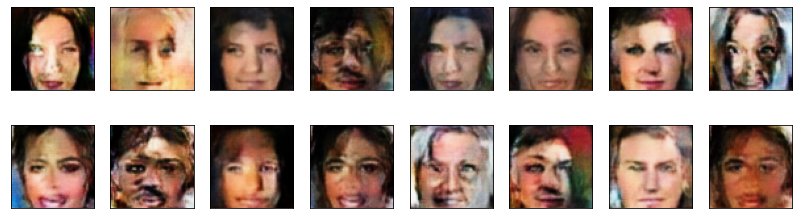

In [71]:
# Hyperparameters
lambda_gp = 10  # Gradient penalty coefficient
losses = []
for epoch in range(n_epochs):
    for batch_i, real_images in enumerate(dataloader):
        real_images = real_images.to(device)
        
        # Train the discriminator
        d_optimizer.zero_grad()
        
        # Generate fake images
        noise = torch.randn(real_images.size(0), latent_dim, 1, 1).to(device)
        fake_images = generator(noise)
        
        # Discriminator loss for real and fake images
        real_scores = discriminator(real_images)
        fake_scores = discriminator(fake_images)
        
        gp = gradient_penalty(discriminator, real_images, fake_images)
        d_loss = fake_scores.mean() - real_scores.mean() + lambda_gp * gp
        
        d_loss.backward()
        d_optimizer.step()
        
        # Train the generator every second loop
        if batch_i % 2 == 0:
            g_optimizer.zero_grad()
            
            noise = torch.randn(real_images.size(0), latent_dim, 1, 1).to(device)
            fake_images = generator(noise)
            fake_scores = discriminator(fake_images)
            
            g_loss = -fake_scores.mean()
            
            g_loss.backward()
            g_optimizer.step()
        
        
        d = d_loss.item()
        g = g_loss.item()
        losses.append((d, g))        
        # Print and display results
        if batch_i % print_every == 0:
            time = str(datetime.now()).split('.')[0]
            print(f'{time} | Epoch [{epoch+1}/{n_epochs}] | Batch {batch_i}/{len(dataloader)} | d_loss: {d_loss.item():.4f} | g_loss: {g_loss.item():.4f}')
    
    generator.eval()
    generated_images = generator(noise)
    display(generated_images)
    generator.train()


### Training losses

Plot the training losses for the generator and discriminator.

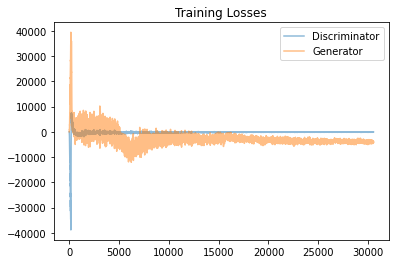

In [72]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

### Question: What do you notice about your generated samples and how might you improve this model?
When you answer this question, consider the following factors:
* The dataset is biased; it is made of "celebrity" faces that are mostly white
* Model size; larger models have the opportunity to learn more features in a data feature space
* Optimization strategy; optimizers and number of epochs affect your final result
* Loss functions

**Answer:** The generated faces tend to look similar to each other and often lack diversity in terms of age, gender, and ethnicity. This suggests that the model may not have captured the full range of facial features present in the real world. The generated faces lack sharpness and fine details. The images are blurry, and facial features like eyes, nose, and mouth are not be well-defined. Exploring more advanced model architectures, such as progressive GANs or architectures with attention mechanisms, could enhance the model's ability to capture fine details and produce higher-quality images. Adjusting hyperparameters like learning rates, batch sizes, and the number of training epochs can lead to improved convergence and better image quality. Regularly monitoring the training process is crucial for finding the optimal settings. Experimenting with different loss functions, including perceptual loss or feature matching loss, may help in generating more realistic and detailed images.

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb".  

Submit the notebook using the ***SUBMIT*** button in the bottom right corner of the Project Workspace.